# Week 5A: More Geospatial Analysis: Urban Networks

- Monday, October 2, 2023
- Section 401

In [1]:
# The usual imports
import altair as alt
import geopandas as gpd
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

In [2]:
# Show all columns in dataframes
pd.options.display.max_columns = 999

In [3]:
# Hide warnings due to issue in shapely package 
# See: https://github.com/shapely/shapely/issues/1345
np.seterr(invalid="ignore");

## Today: Urban street networks and OpenStreetMap (OSM)

- Two tools that make working with OSM data very easy
- What kind of questions can we answer?
    - Street orientations 
    - Mapping event points to streets: car crashes
    - Mapping amenities
    - Network-constrained distances: accessibility

## OSM: what is it?

- Collaborative mapping
- A free editable map of the World
- Sort of like Wikipedia for maps

**Great source of data: street networks and a wealth of amenity information**

https://www.openstreetmap.org

## Working with OSM data

- Raw data is very messy
- Two relatively new, amazing Python packages greatly simply the process
- Related, but complementary features    
    - **OSMnx:** downloading and manipulating streets as networks
    - **Pandana:** networks focused on accessibility of amenities
    
**Related:** interactive web maps in Python

## Part 1: OSMnx

Relatively new package (just a few years old), but quickly becoming the go to package for working with street networks and OpenStreetMap data in Python.

Several key features: 

- Downloading political boundaries for cities, states, countries, etc
- Downloading street networks
- Analyzing networks: routing, visualization, statistics

  - [GitHub](https://github.com/gboeing/osmnx)
  - [Introductory Blog Post](https://geoffboeing.com/2016/11/osmnx-python-street-networks/)
  - [Jupyter Notebook Examples](https://github.com/gboeing/osmnx-examples/tree/master/notebooks) ([Binder](https://mybinder.org/v2/gh/gboeing/osmnx-examples/main?urlpath=/tree/notebooks))
  - [Documentation](https://osmnx.readthedocs.io)

In [4]:
import osmnx as ox

### 1.1. Getting boundary shapefiles from OSM

Key function: `geocode_to_gdf()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.geocoder.geocode_to_gdf))

We can get the boundary for anything identified as a "place" by OSM.

**Important: Be careful to pass the right place name that OSM needs**

In [5]:
philly = ox.geocode_to_gdf("Philadelphia, PA")
philly.head()

,geometry,bbox_north,bbox_south,bbox_east,bbox_west,place_id,osm_type,osm_id,lat,lon,class,type,place_rank,importance,addresstype,name,display_name
0,"POLYGON ((-75.28030 39.97500, -75.28022 39.974...",40.137959,39.867005,-74.955831,-75.280298,14128726,relation,188022,39.952724,-75.163526,boundary,administrative,16,0.713797,city,Philadelphia,"Philadelphia, Pennsylvania, United States"


In [6]:
philly.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

We can plot it just like any other GeoDataFrame

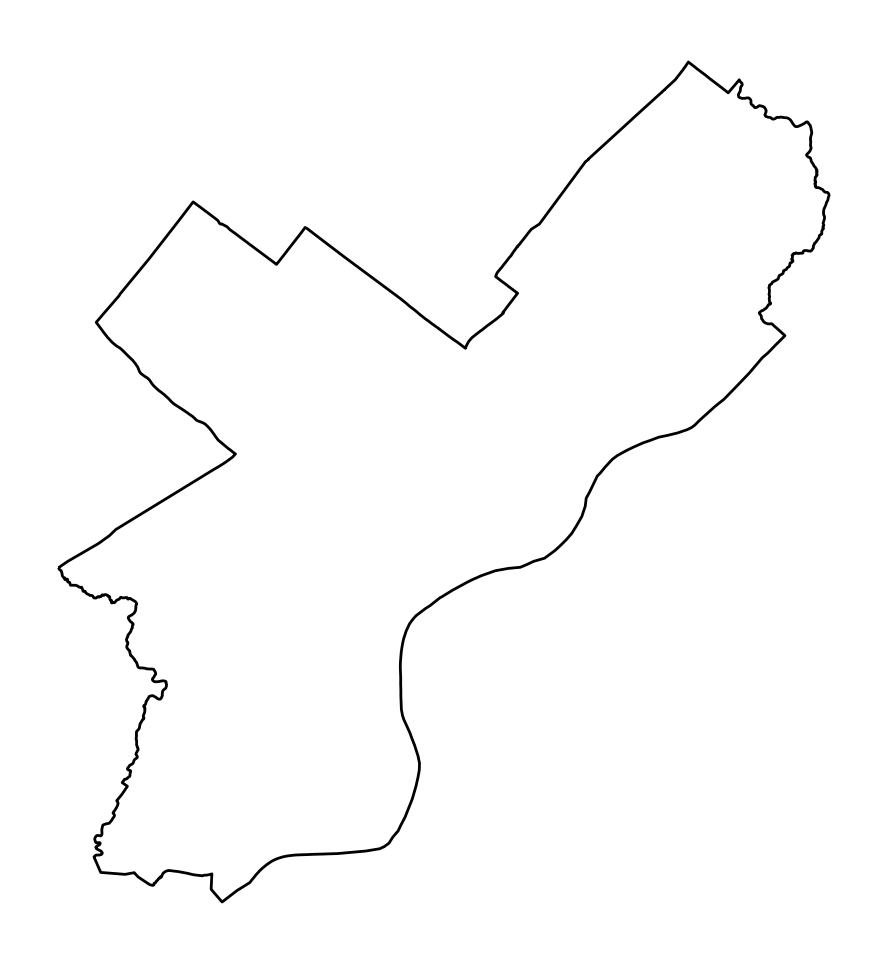

In [7]:
# Project it to Web Mercator first and plot
ax = philly.to_crs(epsg=3857).plot(facecolor="none", edgecolor="black")
ax.set_axis_off()

### 1.2 Projecting with OSMnx

Key function: `project_gdf()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.projection.project_gdf))

Automatically projects to the [Universal Transverse Mercator](https://en.wikipedia.org/wiki/Universal_Transverse_Mercator_coordinate_system) (UTM) CRS for the UTM zone that the centroid of the polygon lies in 

A good, general projection that works for most latitudes except very northern locations.

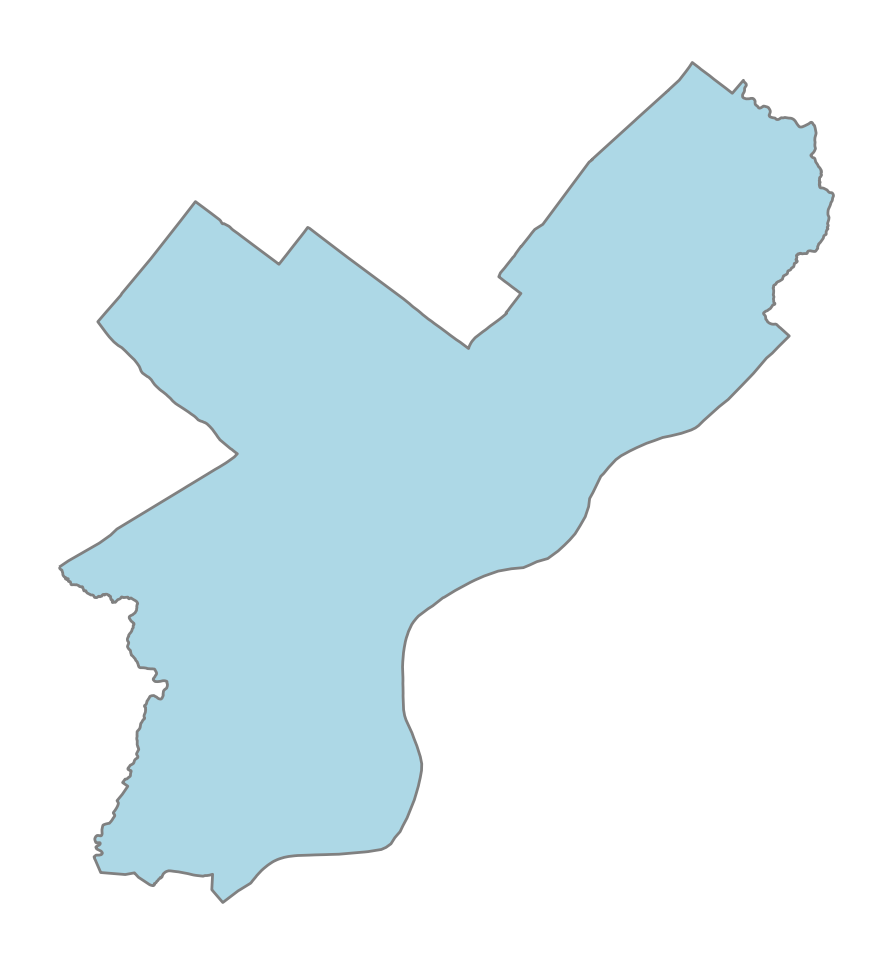

In [8]:
ax = ox.project_gdf(philly).plot(fc="lightblue", ec="gray")
ax.set_axis_off()

Some more examples:

In [9]:
# Some examples
place1 = ox.geocode_to_gdf("Manhattan, New York City, New York, USA")
place2 = ox.geocode_to_gdf("Miami-Dade County, Florida")
place3 = ox.geocode_to_gdf("Florida, USA")
place4 = ox.geocode_to_gdf("Spain")

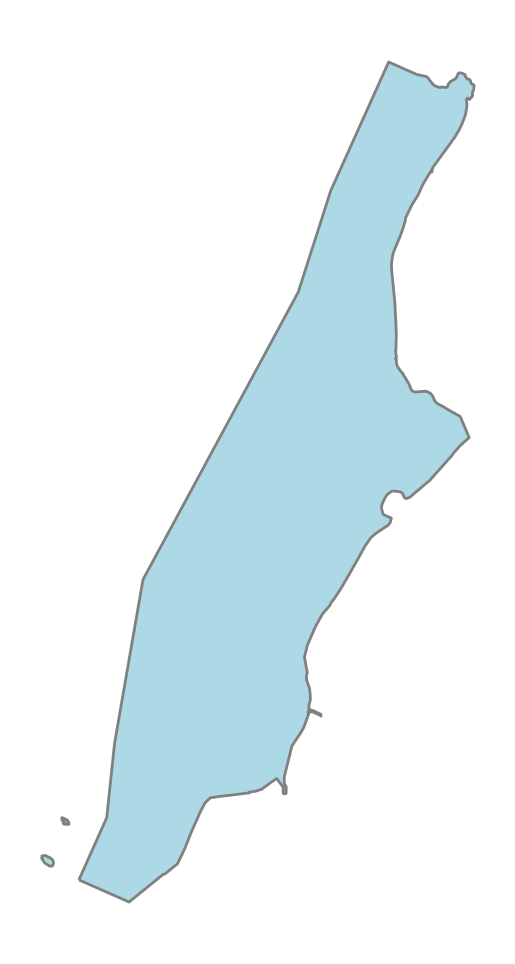

In [10]:
# Manhattan
ax = ox.project_gdf(place1).plot(fc="lightblue", ec="gray")
ax.set_axis_off()

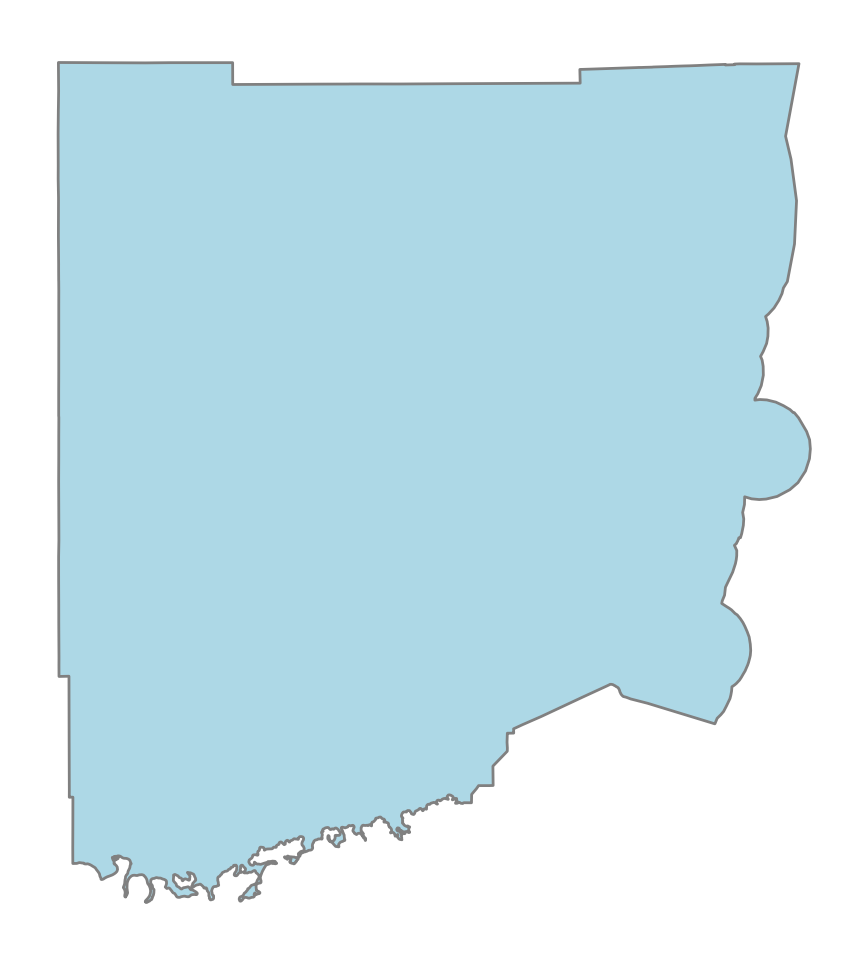

In [11]:
# Miami-Dade County
ax = ox.project_gdf(place2).plot(fc="lightblue", ec="gray")
ax.set_axis_off()

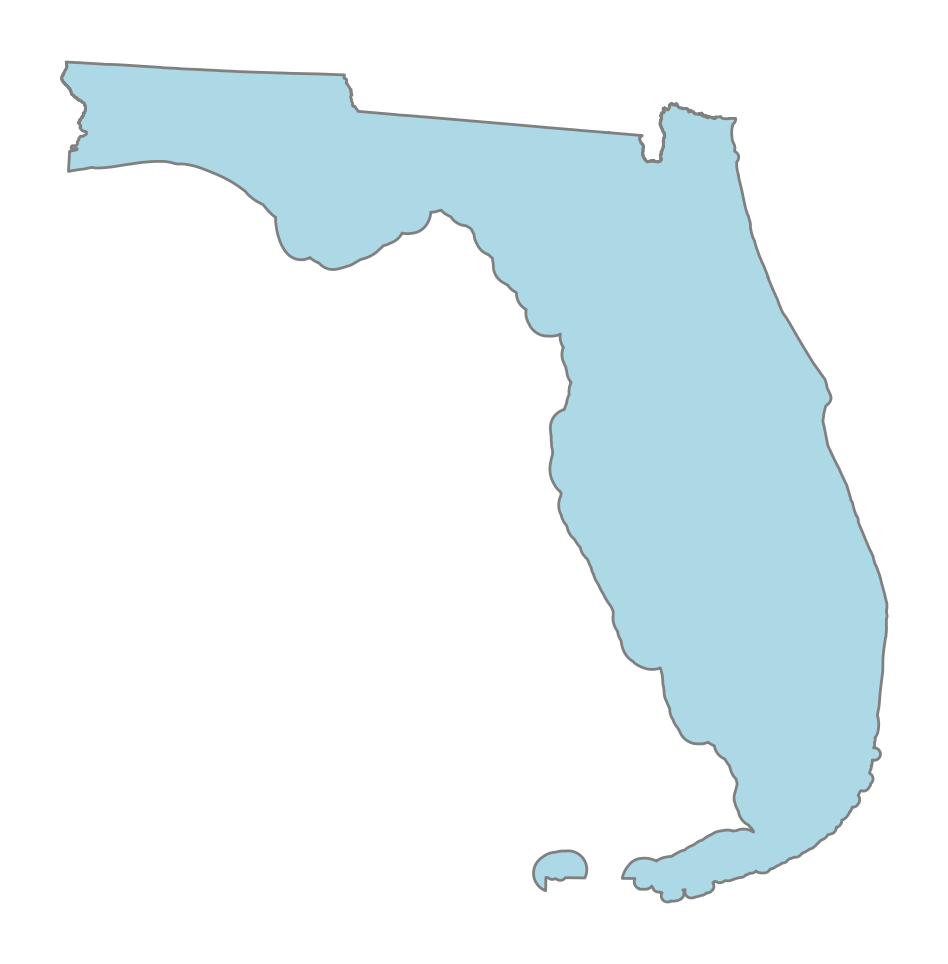

In [12]:
# Florida
ax = ox.project_gdf(place3).plot(fc="lightblue", ec="gray")
ax.set_axis_off()

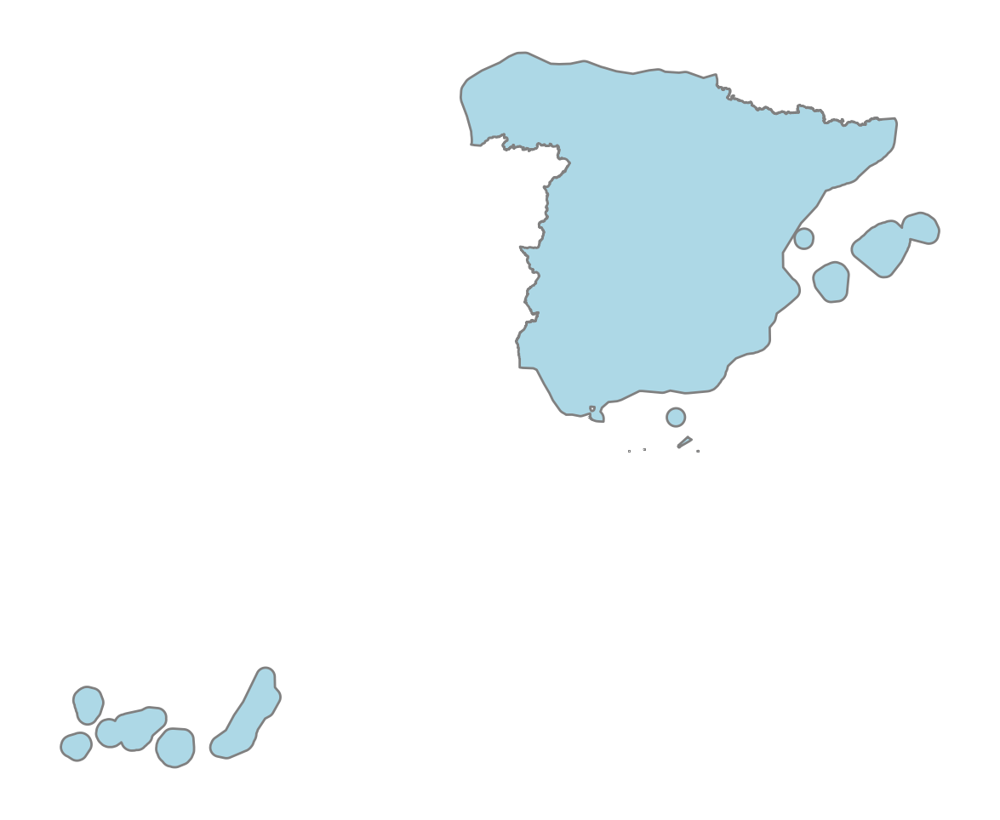

In [13]:
# Spain
ax = ox.project_gdf(place4).plot(fc="lightblue", ec="gray")
ax.set_axis_off()

### 1.3 Downloading OSM features

Key functions: `features_from_*`

- `features_from_place()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.features.features_from_place))
     - Download features within an OSM place boundary
- `features_from_address()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.features.features_from_address))
    - Download features within a certain distance of an address
- `features_from_bbox()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.features.features_from_bbox))
    - Download features within a N, S, E, W bounding box
- `features_from_point()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.features.features_from_point)) 
    - Download features within a certain distance of a specified point
- `features_from_polygon()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.features.features_from_polygon))
    - Download features within a polygon object

::: {.callout-note}
### About OSM features

**Important reference:** https://wiki.openstreetmap.org/wiki/Map_Features

- OSM uses a *tagging* system to categorize different map features
- The main feature categories are available on the OSM Wikipedia
    - Examples: 'amenity', 'building', 'landuse', 'highway'
- There are specific sub-categories for each feature type too:
    - Amenity examples: 'bar', 'college', 'library'

In the language of OSM, the "key" is the main feature category (e.g., amenity) and the "value" is the sub-category type (e.g., "bar")
:::

`osmnx` mirrors the key/value syntax of OSM. Use a dict to specify the features you want: 

In [14]:
# Get all amenities in Philadelphia
amenities = ox.features_from_place("Philadelphia, PA", tags={"amenity": True})

In [15]:
len(amenities)

10647

In [16]:
amenities.head()

geometry      amenity  \
element_type osmid                                                
node         109811385  POINT (-75.19487 40.05846)        bench   
             274215467  POINT (-75.19492 39.95935)    fast_food   
             274216093  POINT (-75.19125 39.95764)          atm   
             274217596  POINT (-75.19229 39.95301)         cafe   
             313440966  POINT (-75.16694 39.96394)  car_sharing   

                            created_by      cuisine            name  \
element_type osmid                                                    
node         109811385             NaN          NaN             NaN   
             274215467   Potlatch 0.9c        pizza  Powelton Pizza   
             274216093             NaN          NaN        Citibank   
             274217596             NaN  coffee_shop       Starbucks   
             313440966  Potlatch 0.10f          NaN             NaN   

                            brand brand:wikidata brand:wikipedia  operator  \
element_type osmid                                                           
node         109811385        NaN            NaN             NaN       NaN   
             274215467        NaN            NaN             NaN       NaN   
             274216093   Citibank        Q857063     en:Citibank  Citibank   
             274217596  Starbucks         Q37158    en:Starbucks       NaN   
             313440966        NaN            NaN             NaN       NaN   

                       operator:wikidata operator:wikipedia short_name  \
element_type osmid                                                       
node         109811385               NaN                NaN        NaN   
             274215467               NaN                NaN        NaN   
             274216093           Q857063        en:Citibank       Citi   
             274217596               NaN                NaN        NaN   
             313440966               NaN                NaN        NaN   

                           addr:city addr:housenumber addr:postcode  \
element_type osmid                                                    
node         109811385           NaN              NaN           NaN   
             274215467           NaN              NaN           NaN   
             274216093           NaN              NaN           NaN   
             274217596  Philadelphia             3401         19104   
             313440966           NaN              NaN           NaN   

                       addr:state    addr:street  \
element_type osmid                                 
node         109811385        NaN            NaN   
             274215467        NaN            NaN   
             274216093        NaN            NaN   
             274217596         PA  Walnut Street   
             313440966        NaN            NaN   

                                                          contact:website  \
element_type osmid                                                          
node         109811385                                                NaN   
             274215467                                                NaN   
             274216093                                                NaN   
             274217596  https://www.starbucks.com/store-locator/store/...   
             313440966                                                NaN   

                           official_name  \
element_type osmid                         
node         109811385               NaN   
             274215467               NaN   
             274216093               NaN   
             274217596  Starbucks Coffee   
             313440966               NaN   

                                               opening_hours         phone  \
element_type osmid                                                           
node         109811385                                   NaN           NaN   
             274215467                                   NaN  

In [17]:
# Get all bars in philadelphia
bars = ox.features_from_place("Philadelphia, PA", tags={"amenity": "bar"})

In [18]:
len(bars)

165

In [19]:
bars.head()

addr:city addr:housenumber addr:postcode  \
element_type osmid                                                     
node         357303425   Philadelphia              500         19123   
             655425272            NaN              NaN           NaN   
             1033935437           NaN             2101           NaN   
             1167079387           NaN              401           NaN   
             1204761128           NaN              NaN           NaN   

                        addr:state           addr:street amenity brewery  \
element_type osmid                                                         
node         357303425          PA  Spring Garden Street     bar     yes   
             655425272         NaN                   NaN     bar     NaN   
             1033935437        NaN       Chestnut Street     bar     NaN   
             1167079387        NaN          South Street     bar     NaN   
             1204761128        NaN                   NaN     bar     NaN   

                           craft gnis:county_id microbrewery  \
element_type osmid                                             
node         357303425   brewery            101          yes   
             655425272       NaN            NaN          NaN   
             1033935437      NaN            NaN          NaN   
             1167079387      NaN            NaN          NaN   
             1204761128      NaN            NaN          NaN   

                                             name               operator  \
element_type osmid                                                         
node         357303425      Yards Brewing Company  Yards Brewing Company   
             655425272              Drinkers West                    NaN   
             1033935437           Mix Bar & Grill                    NaN   
             1167079387      MilkBoy South Street                    NaN   
             1204761128  Vikings High School Club                    NaN   

                        restaurant                    website   wikidata  \
element_type osmid                                                         
node         357303425         yes  https://yardsbrewing.com/  Q16903914   
             655425272         NaN                        NaN        NaN   
             1033935437        NaN                        NaN        NaN   
             1167079387        NaN                        NaN        NaN   
             1204761128        NaN                        NaN        NaN   

                                        wikipedia                    geometry  \
element_type osmid                                                              
node         357303425   en:Yards Brewing Company  POINT (-75.14712 39.96067)   
             655425272                        NaN  POINT (-75.20020 39.95521)   
             1033935437                       NaN  POINT (-75.17552 39.95242)   
             1167079387                       NaN  POINT (-75.14925 39.94170)   
             1204761128                       NaN  POINT (-75.16363 39.92685)   

                           contact:phone  \
element_type osmid                         
node         357303425               NaN   
             655425272               NaN   
             1033935437  +1 215-568-3355   
             1167079387  +1 215-925-6455   
             1204761128              NaN   

                                                           contact:website  \
element_type osmid                                                           
node         357303425                                                 NaN   
             655425272                                                 NaN   
             1033935437  https://mixbarandgrillphilly.com/location/mix-...   
             1167079387                 https://www.milkboy.tv/southstreet   
             1204761128                                                NaN   

                                                   

In [20]:
# Get bar, pub, and restaurant features in Philadelphia
food_and_drink = ox.features_from_place(
    "Philadelphia, PA", tags={"amenity": ["pub", "bar", "restaurant"]}
)

In [21]:
len(food_and_drink)

1075

In [22]:
food_and_drink.head()

amenity      created_by  \
element_type osmid                                   
node         333786044  restaurant  Potlatch 0.10f   
             343293806         pub             NaN   
             357303425         bar             NaN   
             566683522  restaurant             NaN   
             596230881  restaurant             NaN   

                                                    name     source  \
element_type osmid                                                    
node         333786044               Sam's Morning Glory  knowledge   
             343293806               Prohibition Taproom     survey   
             357303425             Yards Brewing Company        NaN   
             566683522  Spring Garden Pizza & Restaurant        NaN   
             596230881                               NaN        NaN   

                       wheelchair                    geometry     addr:city  \
element_type osmid                                                            
node         333786044    limited  POINT (-75.15893 39.94086)           NaN   
             343293806        NaN  POINT (-75.15946 39.96073)  Philadelphia   
             357303425        NaN  POINT (-75.14712 39.96067)  Philadelphia   
             566683522        NaN  POINT (-75.15755 39.96205)           NaN   
             596230881        NaN  POINT (-75.18682 40.05492)           NaN   

                       addr:housenumber addr:postcode addr:state  \
element_type osmid                                                 
node         333786044              NaN           NaN        NaN   
             343293806              501         19123         PA   
             357303425              500         19123         PA   
             566683522              NaN           NaN        NaN   
             596230881              NaN           NaN        NaN   

                                 addr:street brewery      opening_hours  \
element_type osmid                                                        
node         333786044                   NaN     NaN                NaN   
             343293806     North 13th Street     yes  Mo-Su 11:00-02:00   
             357303425  Spring Garden Street     yes                NaN   
             566683522                   NaN     NaN                NaN   
             596230881                   NaN     NaN                NaN   

                          craft gnis:county_id microbrewery  \
element_type osmid                                            
node         333786044      NaN            NaN          NaN   
             343293806      NaN            NaN          NaN   
             357303425  brewery            101          yes   
             566683522      NaN            NaN          NaN   
             596230881      NaN            NaN          NaN   

                                     operator restaurant  \
element_type osmid                                         
node         333786044                    NaN        NaN   
             343293806                    NaN        NaN   
             357303425  Yards Brewing Company        yes   
             566683522                    NaN        NaN   
             596230881                    NaN        NaN   

                                          website   wikidata  \
element_type osmid                                             
node         333786044                        NaN        NaN   
             343293806                        NaN        NaN   
             357303425  https://yardsbrewing.com/  Q16903914   
             566683522                        NaN        NaN   
             596230881                        NaN        NaN   

                                       wikipedia cuisine outdoor_seating  \
element_type osmid                                                         
node         333786044                       NaN     NaN             NaN   
             343293806                       NaN     

In [23]:
# Get bus stop features
bus_stops = ox.features_from_place("Philadelphia, PA", tags={"highway": "bus_stop"})

In [24]:
len(bus_stops)

290

In [25]:
bus_stops.head()

bench  bus covered   highway  \
element_type osmid                                     
node         361011456    yes  yes     yes  bus_stop   
             750281693    NaN  yes     NaN  bus_stop   
             768271130    NaN  yes     NaN  bus_stop   
             1015342921   NaN  yes     NaN  bus_stop   
             1015342926   NaN  yes     NaN  bus_stop   

                                                      name network  \
element_type osmid                                                   
node         361011456                 13th St & Market St   SEPTA   
             750281693                                 NaN     NaN   
             768271130   Wissahickon Transportation Center   SEPTA   
             1015342921                                NaN     NaN   
             1015342926                                NaN     NaN   

                        network:wikidata operator public_transport shelter  \
element_type osmid                                                           
node         361011456          Q2037863    SEPTA         platform     yes   
             750281693               NaN      NaN         platform     NaN   
             768271130          Q2037863    SEPTA         platform     yes   
             1015342921              NaN      NaN         platform     NaN   
             1015342926              NaN      NaN         platform     NaN   

                                           geometry network:wikipedia  ref  \
element_type osmid                                                           
node         361011456   POINT (-75.16166 39.95223)               NaN  NaN   
             750281693   POINT (-75.07732 40.01797)               NaN  NaN   
             768271130   POINT (-75.20726 40.01487)               NaN  NaN   
             1015342921  POINT (-75.18187 39.96640)               NaN  NaN   
             1015342926  POINT (-75.18024 39.96670)               NaN  NaN   

                        tactile_paving wheelchair route_ref local_ref  \
element_type osmid                                                      
node         361011456             NaN        NaN       NaN       NaN   
             750281693             NaN        NaN       NaN       NaN   
             768271130             NaN        NaN       NaN       NaN   
             1015342921            NaN        NaN       NaN       NaN   
             1015342926            NaN        NaN       NaN       NaN   

                        designation source  bin  lit departures_board  \
element_type osmid                                                      
node         361011456          NaN    NaN  NaN  NaN              NaN   
             750281693          NaN    NaN  NaN  NaN              NaN   
             768271130          NaN    NaN  NaN  NaN              NaN   
             1015342921         NaN    NaN  NaN  NaN              NaN   
             1015342926         NaN    NaN  NaN  NaN              NaN   

                        internet_access addr:street route_ref_1 description  \
element_type osmid                                                            
node         361011456              NaN         NaN         NaN         NaN   
             750281693              NaN         NaN         NaN         NaN   
             768271130              NaN         NaN         NaN         NaN   
             1015342921             NaN         NaN         NaN         NaN   
             1015342926             NaN         NaN         NaN         NaN   

                        note operator:wikidata brand brand:wikidata railway  \
element_type osmid                                                            
node         361011456   NaN               NaN   NaN            NaN     NaN   
             750281693   NaN               NaN   NaN            NaN     NaN   
             768271130   NaN               NaN   NaN            NaN     NaN   
             1015342921  NaN               NaN   NaN            NaN     N

In [26]:
# Get commercial and retail landuse features
landuse = ox.features_from_place(
    "Philadelphia, PA", tags={"landuse": ["commercial", "retail"]}
)

In [27]:
len(landuse)

349

Let's plot the land use features:

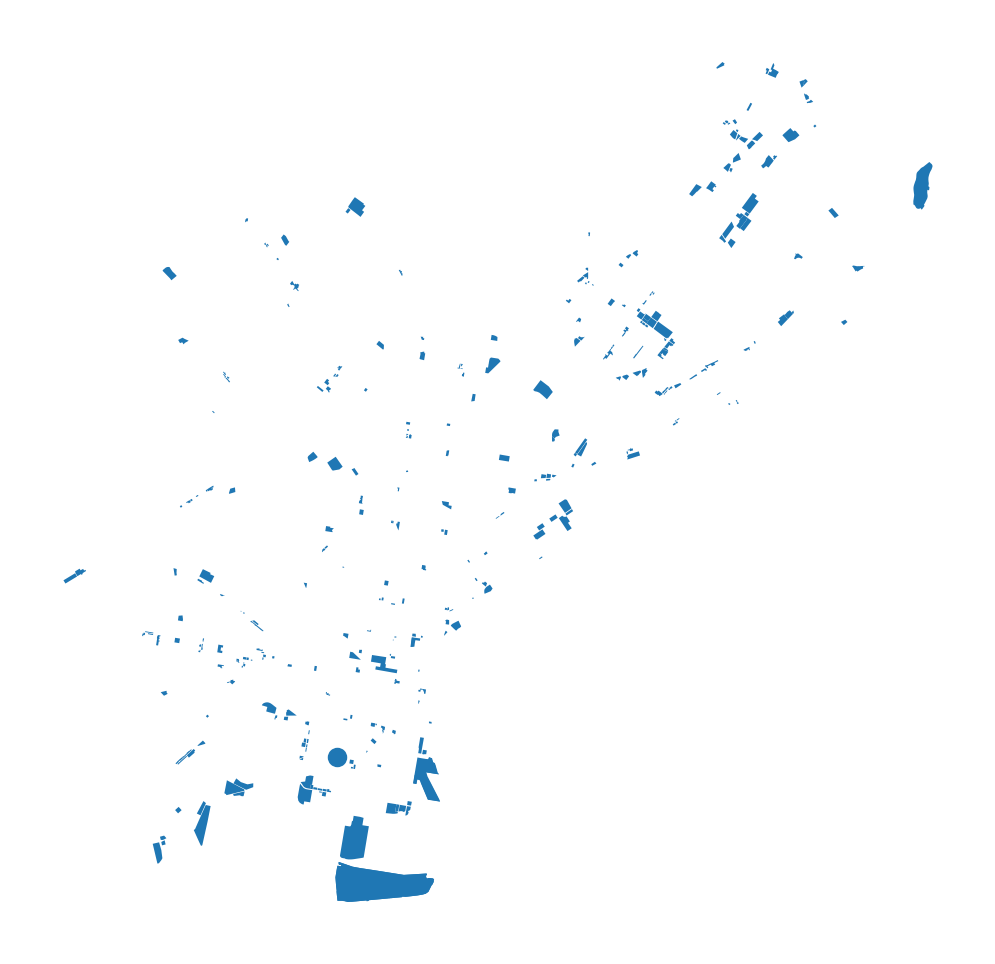

In [28]:
fig, ax = plt.subplots(figsize=(10, 6))

ax = landuse.plot(ax=ax)
ax.set_axis_off()

### 1.4 Downloading street networks

Key functions: `graph_from_*` 

- `graph_from_place()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.graph.graph_from_place))
     - Download street network within an OSM place boundary
- `graph_from_address()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.graph.graph_from_address))
    - Download street network within a certain distance of an address
- `graph_from_bbox()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.graph.graph_from_bbox))
    - Download street network within a N, S, E, W bounding box
- `graph_from_point()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.graph.graph_from_point)) 
    - Download street network within a certain distance of a specified point
- `graph_from_polygon()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.graph.graph_from_polygon))
    - Download street network within a polygon object

#### Street network around an address

Get streets within 500 meters of the center of Center City

In [29]:
G = ox.graph_from_address("Center City, Philadelphia, PA", dist=500)

Project and plot it:

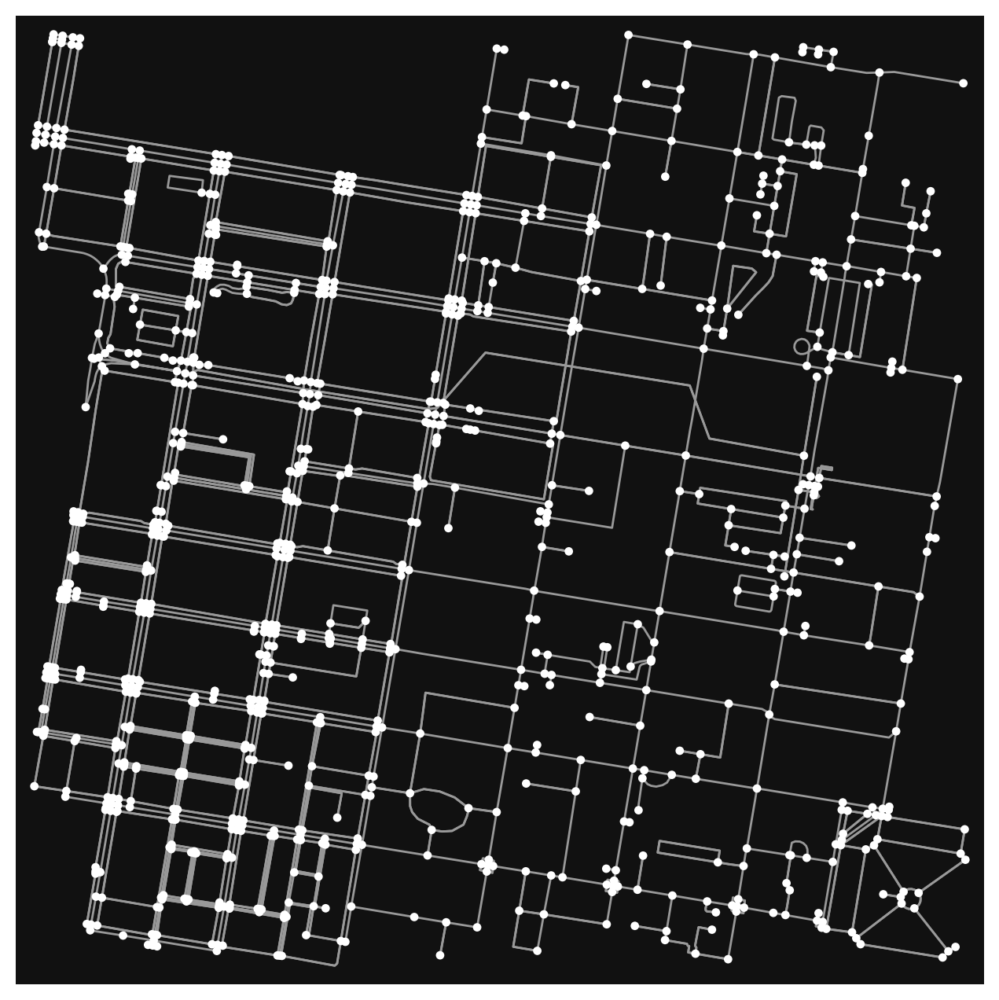

In [30]:
G_projected = ox.project_graph(G)
ox.plot_graph(G_projected);

Remove the nodes:

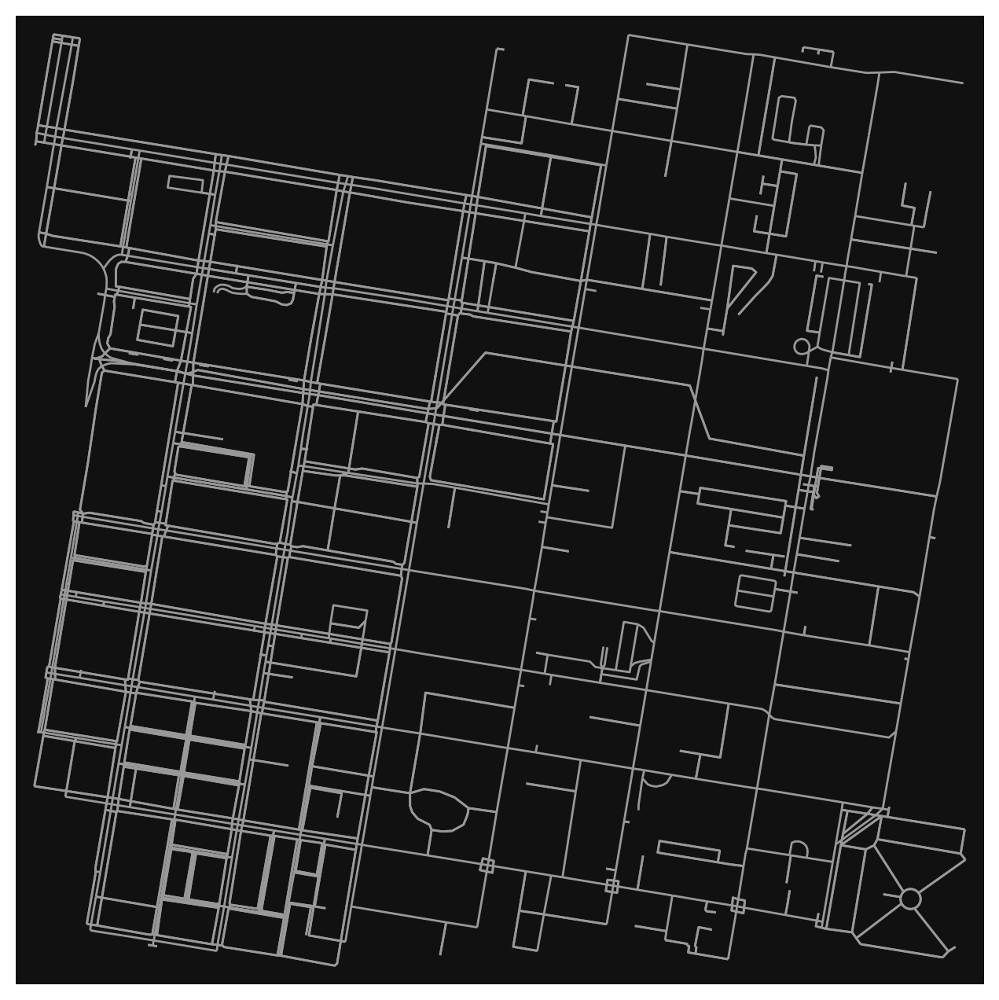

In [31]:
ox.plot_graph(G_projected, node_size=0);

Let's zoom out to 2,000 meters. This will take a little longer.

In [32]:
G = ox.graph_from_address("Center City, Philadelphia, PA", dist=2000)
G_projected = ox.project_graph(G)

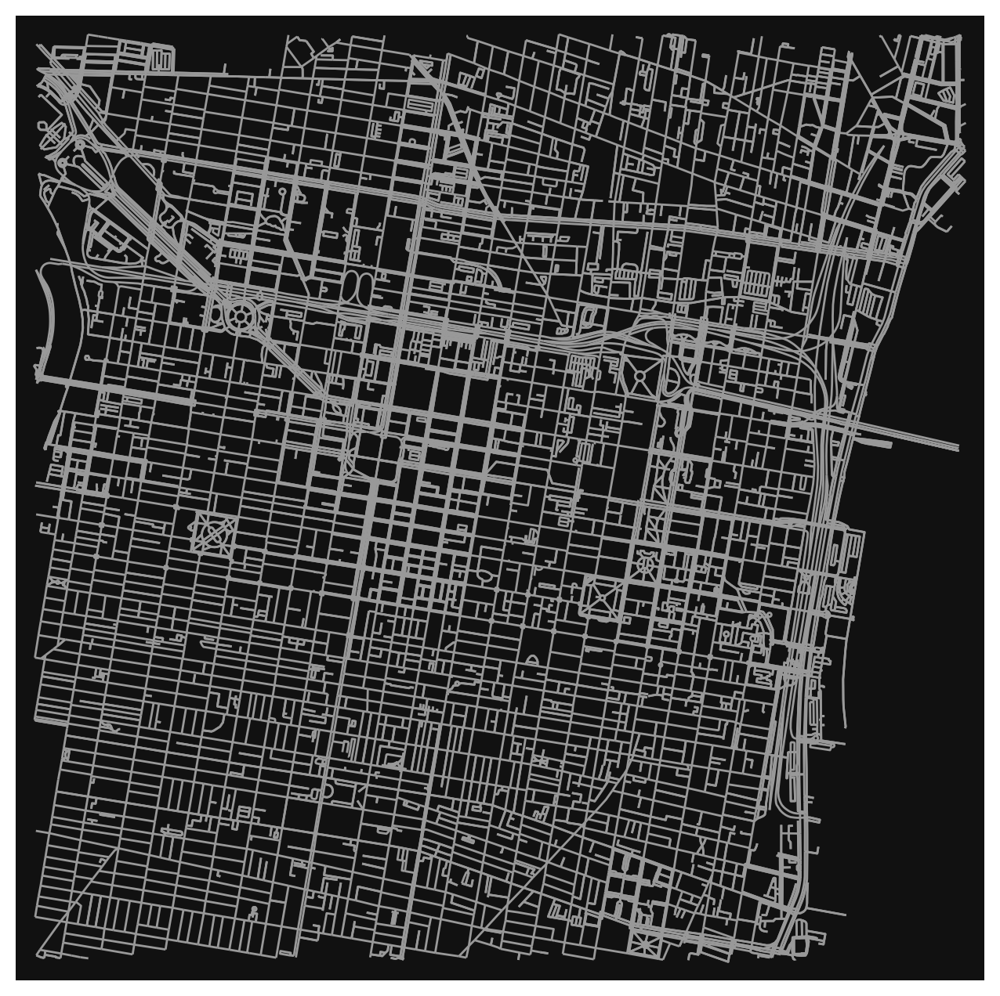

In [33]:
ox.plot_graph(G_projected, node_size=0);

#### Getting different network types

- `drive` - get drivable public streets (but not service roads)
- `drive_service` - get drivable streets, including service roads
- `walk` - get all streets and paths that pedestrians can use (this network type ignores one-way directionality)
- `bike` - get all streets and paths that cyclists can use
- `all` - download all non-private OSM streets and paths
- `all_private` - download all OSM streets and paths, including private-access ones (default)

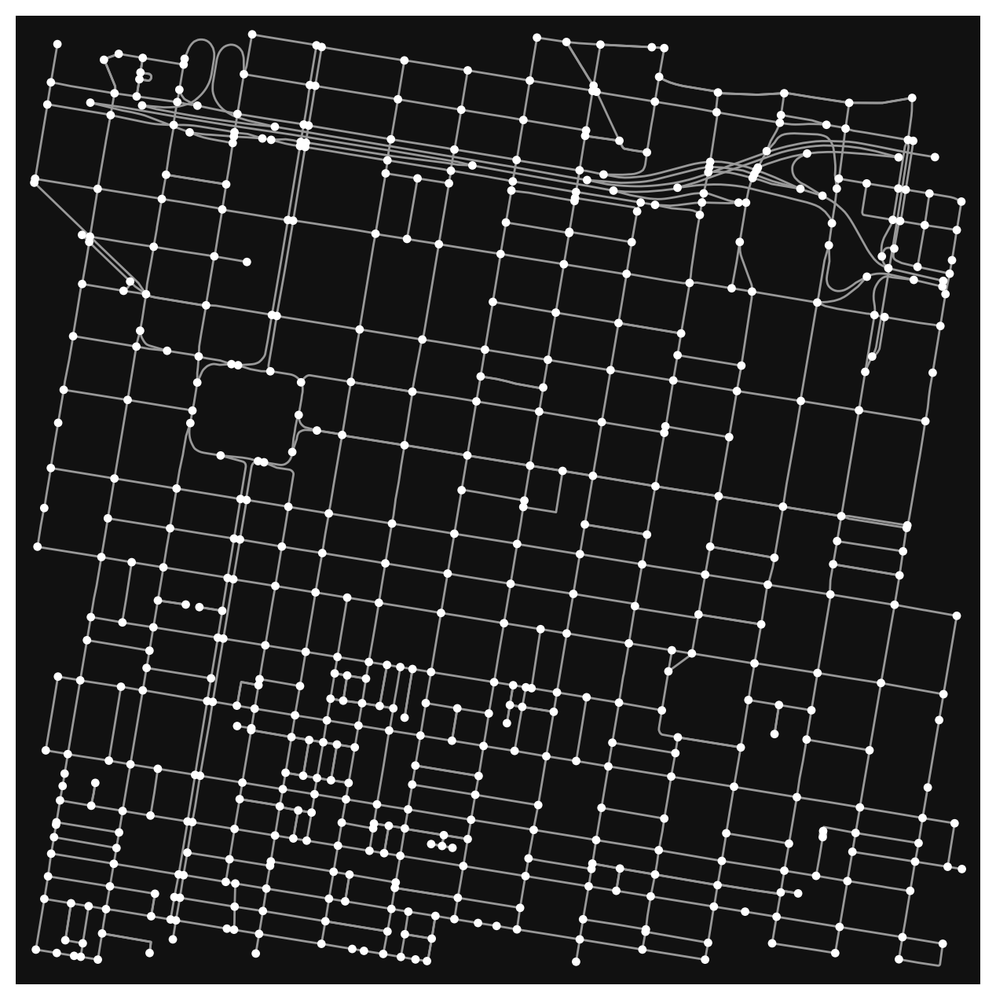

In [34]:
# the "drive" network
G = ox.graph_from_address("Center City, Philadelphia, PA", network_type="drive")
ox.plot_graph(G);

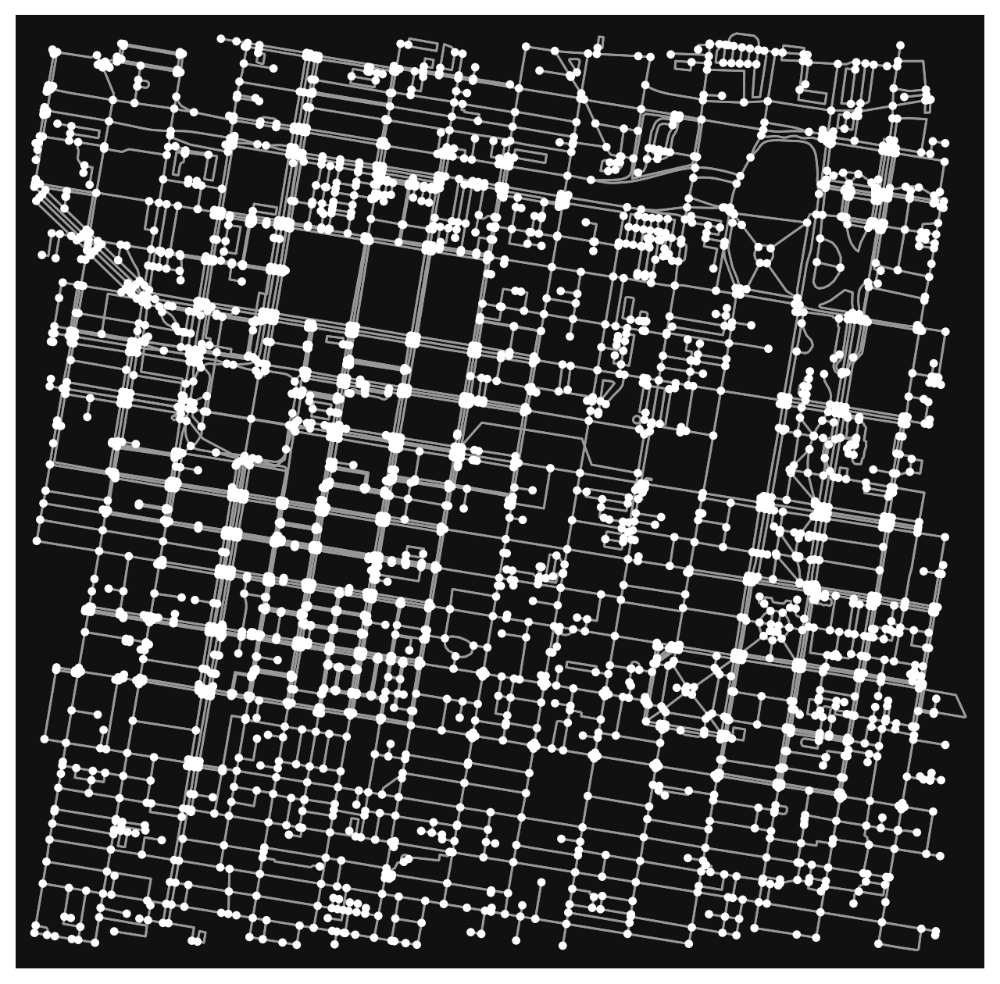

In [35]:
# the "walk" network
G = ox.graph_from_address("Center City, Philadelphia, PA", network_type="walk")
ox.plot_graph(ox.project_graph(G));

#### Street network within a place boundary

Use `graph_from_place()` to get the streets within a specific OSM place.

::: {.callout-caution}

A couple of things to watch out for: 
1. The place query has to be resolved by OSM.
2. If the place is a big city, you might be downloading a lot of data!

:::

Let's check out the street network for Berkeley, CA:

In [36]:
berkeley = ox.graph_from_place("Berkeley, California, USA")

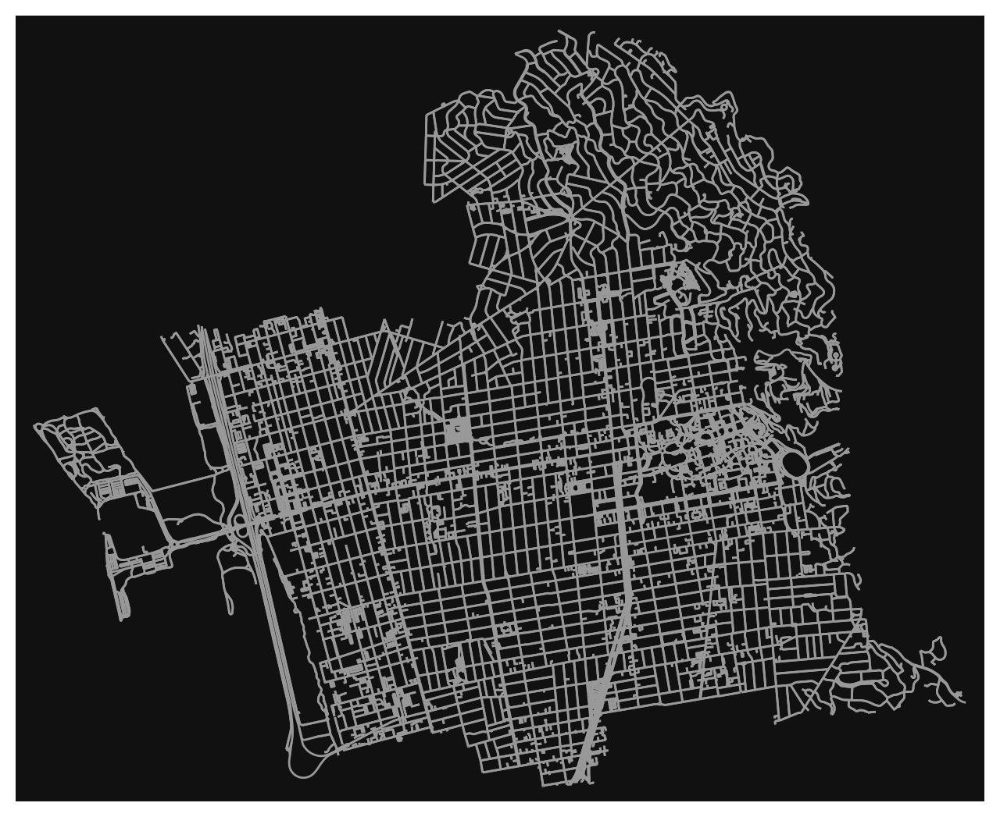

In [37]:
ox.plot_graph(ox.project_graph(berkeley), node_size=0);

#### Streets within a specific polygon

**Example:** Let's download all streets within Center City. We will use the "Central" planning district as a proxy for this area. The city's planning districts are available on [Open Data Philly](https://opendataphilly.org/datasets/planning-districts/).

In [38]:
planning_districts = gpd.read_file(
    "https://opendata.arcgis.com/datasets/0960ea0f38f44146bb562f2b212075aa_0.geojson"
)

In [39]:
planning_districts.head()

,OBJECTID_1,OBJECTID,DIST_NAME,ABBREV,Shape__Area,Shape__Length,PlanningDist,DaytimePop,geometry
0,1,14,River Wards,RW,2.107270e+08,66931.595020,NaN,NaN,"POLYGON ((-75.09798 40.00496, -75.09687 40.005..."
1,2,3,North Delaware,NDEL,2.700915e+08,89213.074378,NaN,NaN,"POLYGON ((-74.98159 40.05363, -74.98139 40.053..."
2,3,0,Lower Far Northeast,LFNE,3.068529e+08,92703.285159,NaN,NaN,"POLYGON ((-74.96443 40.11728, -74.96434 40.117..."
3,4,9,Central,CTR,1.782880e+08,71405.143450,NaN,NaN,"POLYGON ((-75.14791 39.96733, -75.14715 39.967..."
4,5,10,University Southwest,USW,1.296468e+08,65267.676141,NaN,NaN,"POLYGON ((-75.18742 39.96338, -75.18644 39.963..."


Trim to the central district:

In [40]:
central_district = planning_districts.query("DIST_NAME == 'Central'")

And plot it:

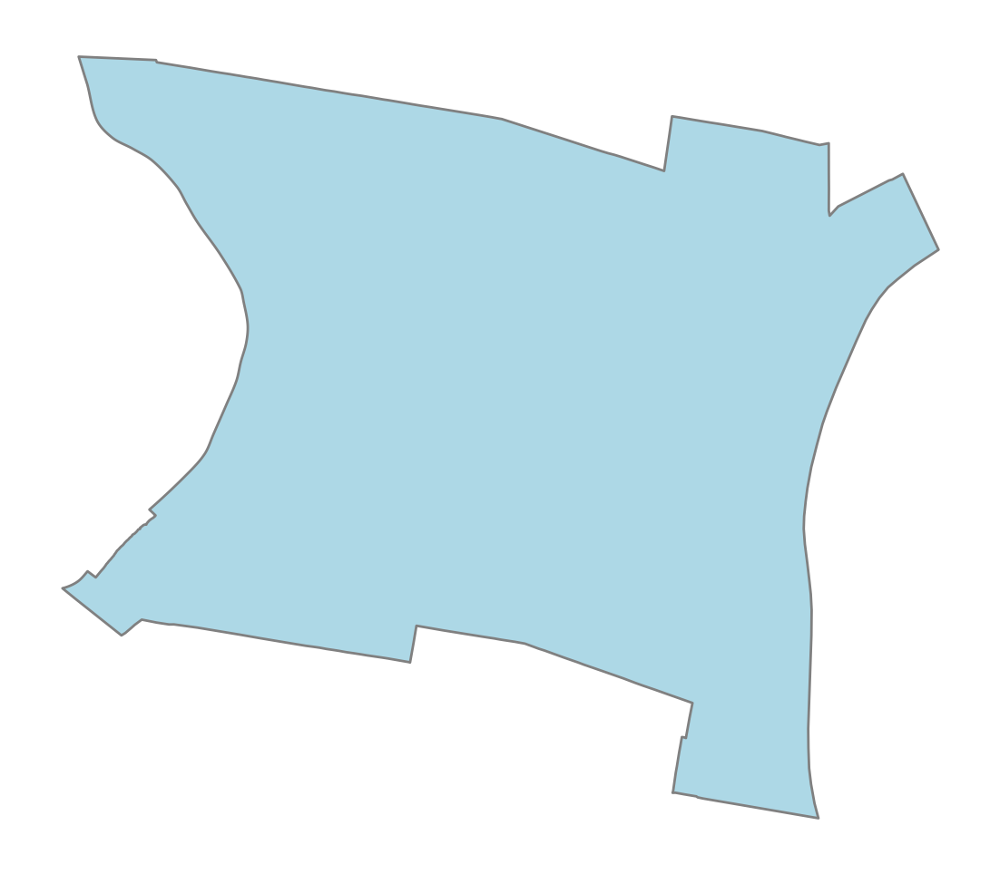

In [41]:
ax = ox.project_gdf(central_district).plot(fc="lightblue", ec="gray")
ax.set_axis_off()

Squeeze it so we can get the geometry polygon:

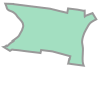

In [42]:
center_city_outline = central_district.squeeze().geometry

center_city_outline

Now, let's use `ox.graph_from_polygon()` to extract streets within this polygon. 

In [43]:
# Get the graph
G_cc = ox.graph_from_polygon(center_city_outline, network_type="drive")

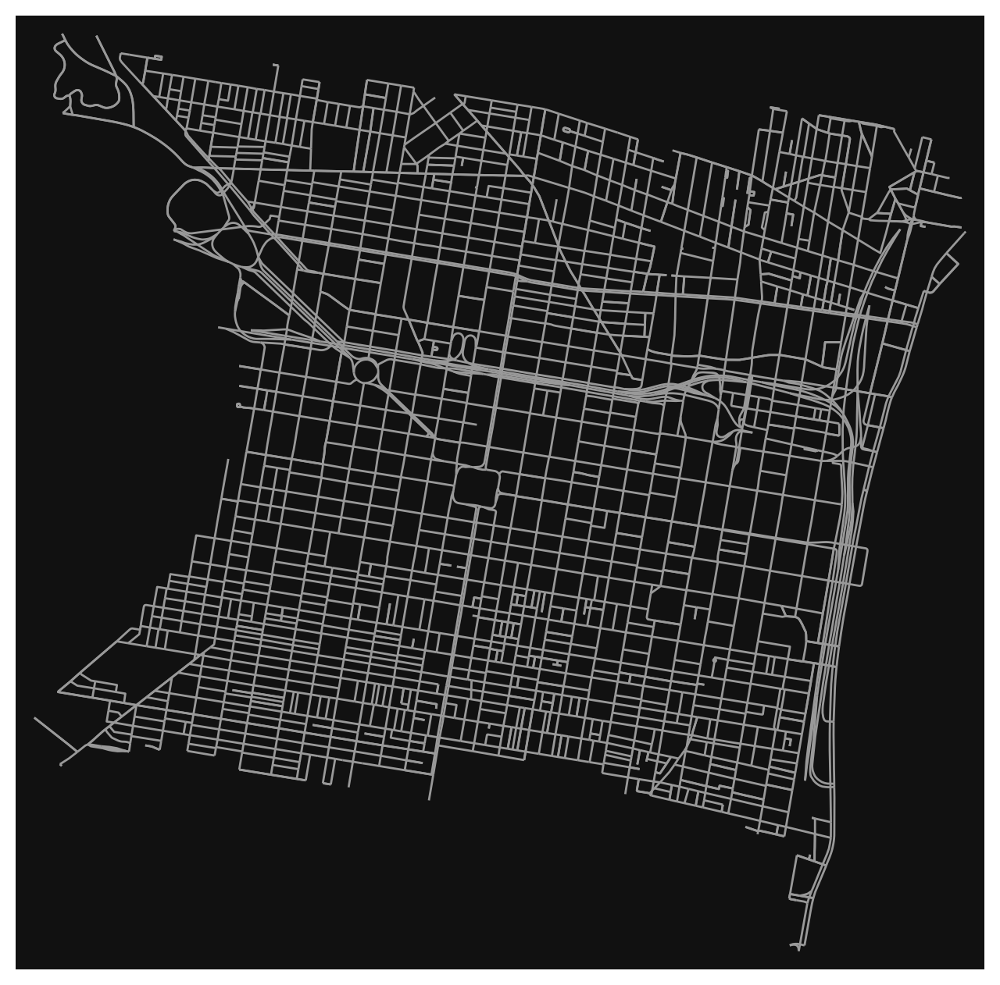

In [44]:
# Viola!
ox.plot_graph(ox.project_graph(G_cc), node_size=0);

### 1.5 Converting from a graph to a GeoDataFrame

Key function: `ox.graph_to_gdfs()` ([docs](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=graph_to_gdf#osmnx.utils_graph.graph_to_gdfs))

You can get a GeoDataFrame for both the nodes (points) and edges (lines)

In [45]:
type(G_cc)

networkx.classes.multidigraph.MultiDiGraph

In [46]:
# only get the edges
cc_edges = ox.graph_to_gdfs(G_cc, edges=True, nodes=False)

In [47]:
# we have lots of data associated with each edge!
cc_edges.head()

osmid  oneway                   name  \
u         v         key                                             
109727439 109911666 0    132508434    True      Bainbridge Street   
109727448 109727439 0     12109011    True  South Colorado Street   
          110034229 0     12159387    True       Fitzwater Street   
109727507 110024052 0    193364514    True       Carpenter Street   
109728761 110274344 0    672312336    True           Brown Street   

                             highway reversed   length  \
u         v         key                                  
109727439 109911666 0    residential    False   44.137   
109727448 109727439 0    residential    False  109.484   
          110034229 0    residential    False   91.353   
109727507 110024052 0    residential    False   53.208   
109728761 110274344 0    residential    False   58.270   

                                                                  geometry  \
u         v         key                                                      
109727439 109911666 0    LINESTRING (-75.17104 39.94345, -75.17053 39.9...   
109727448 109727439 0    LINESTRING (-75.17125 39.94248, -75.17120 39.9...   
          110034229 0    LINESTRING (-75.17125 39.94248, -75.17137 39.9...   
109727507 110024052 0    LINESTRING (-75.17196 39.93973, -75.17134 39.9...   
109728761 110274344 0    LINESTRING (-75.17317 39.96951, -75.17250 39.9...   

                        maxspeed lanes bridge  ref tunnel width service  \
u         v         key                                                   
109727439 109911666 0        NaN   NaN    NaN  NaN    NaN   NaN     NaN   
109727448 109727439 0        NaN   NaN    NaN  NaN    NaN   NaN     NaN   
          110034229 0        NaN   NaN    NaN  NaN    NaN   NaN     NaN   
109727507 110024052 0        NaN   NaN    NaN  NaN    NaN   NaN     NaN   
109728761 110274344 0     25 mph   NaN    NaN  NaN    NaN   NaN     NaN   

                        access junction  
u         v         key                  
109727439 109911666 0      NaN      NaN  
109727448 109727439 0      NaN      NaN  
          110034229 0      NaN      NaN  
109727507 110024052 0      NaN      NaN  
109728761 110274344 0      NaN      NaN

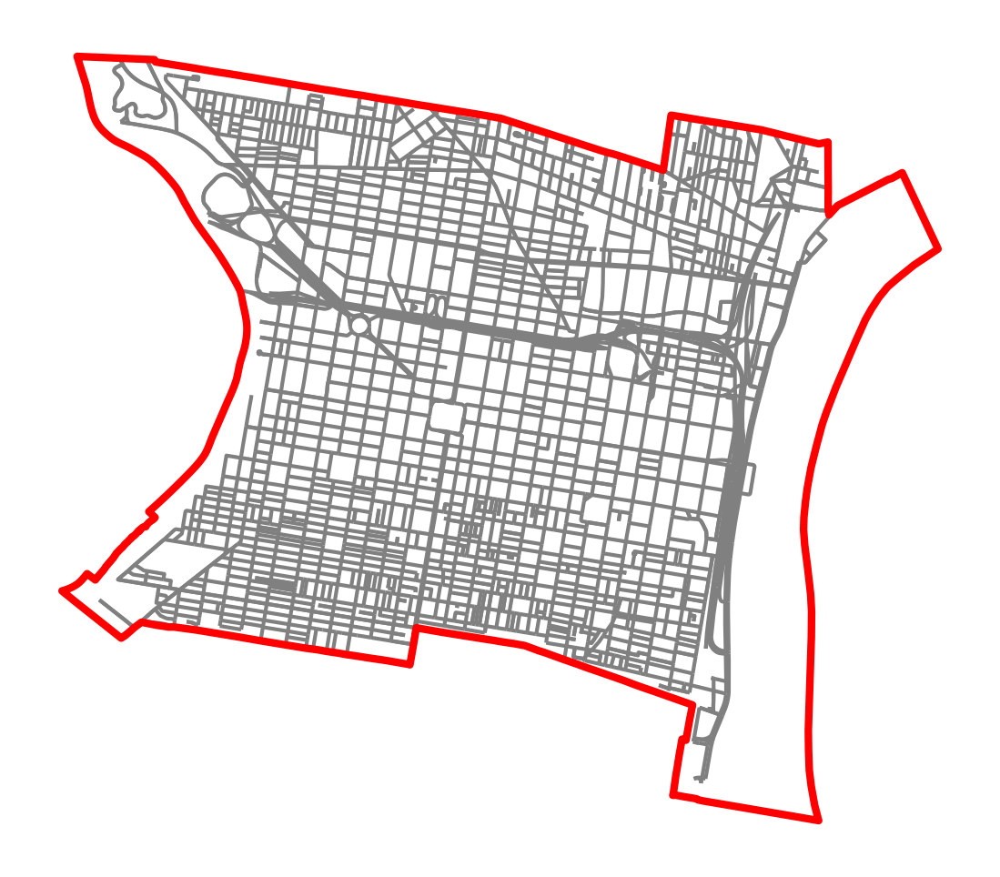

In [48]:
# plot it like any old GeoDataFrame
ax = cc_edges.to_crs(epsg=3857).plot(color="gray")

# add the neighborhood boundaries
boundary = gpd.GeoSeries([center_city_outline], crs="EPSG:4326")
boundary.to_crs(epsg=3857).plot(
    ax=ax, facecolor="none", edgecolor="red", linewidth=3, zorder=2
)

ax.set_axis_off()

**Don't forget:** We can use the `.explore()` function to get an interactive web map via Folium:

In [49]:
cc_edges.explore(tiles='cartodb positron')

### 1.6 What can we do with the graph?

- Network-based statistics
- Routing
- Street orientations
- Visualizing crashes

And much more: see the [OSMnx repository of Jupyter notebook examples](https://github.com/gboeing/osmnx-examples/tree/master/notebooks)

#### Street orientations

A [great blog post](https://geoffboeing.com/2019/09/urban-street-network-orientation/) on street orientations across different US and global cities. 

One of my favorite examples of data viz, using matplotlib for *radial histograms* of street orientations...



![](imgs/street-orientations.png){width=800}

The code for these histograms is available in [the osmnx examples repository](https://github.com/gboeing/osmnx-examples/blob/main/notebooks/17-street-network-orientations.ipynb).

#### Network statistics

We can use the `ox.basic_stats()` to get some basic network statistics

In [50]:
ox.basic_stats(G_cc)

{'n': 2026,
 'm': 3902,
 'k_avg': 3.8519249753208293,
 'edge_length_total': 349745.43700000027,
 'edge_length_avg': 89.63235187083554,
 'streets_per_node_avg': 3.428923988153998,
 'streets_per_node_counts': {0: 0, 1: 55, 2: 9, 3: 996, 4: 948, 5: 14, 6: 4},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.027147087857847977,
  2: 0.004442250740375123,
  3: 0.491609081934847,
  4: 0.46791707798617965,
  5: 0.006910167818361303,
  6: 0.0019743336623889436},
 'intersection_count': 1971,
 'street_length_total': 306400.7959999999,
 'street_segment_count': 3384,
 'street_length_avg': 90.54397044917255,
 'circuity_avg': 1.0172703832466288,
 'self_loop_proportion': 0.0008865248226950354}

#### Finding the shortest route

Let's calculate the shortest route between [the Art Museum](https://www.openstreetmap.org/way/28533972) and the [Liberty Bell](https://www.openstreetmap.org/node/1207480649).

We'll need to download all amenities in Philadelphia of type "tourism".

- The `ox.features_from_place()` can download OSM features with a specific tag
- You can consult the OSM pages ([the Art Museum](https://www.openstreetmap.org/way/28533972) and [Liberty Bell](https://www.openstreetmap.org/node/1207480649)) for each feature for additional info
- Both features are categorized as "tourism" in the OSM data — use the "tags" keyword to select this category

In [51]:
philly_tourism = ox.features_from_place("Philadelphia, PA", tags={"tourism": True})

In [52]:
len(philly_tourism)

593

In [53]:
philly_tourism.head()

ref                    geometry  ele gnis:county_id  \
element_type osmid                                                            
node         357371322  NaN  POINT (-75.19580 39.96970)   17            101   
             360500844  NaN  POINT (-75.19582 39.95352)  NaN            NaN   
             360515304  NaN  POINT (-75.14860 39.94771)  NaN            NaN   
             360542779  NaN  POINT (-75.18932 39.95540)  NaN            NaN   
             360777728  NaN  POINT (-75.19021 39.95230)  NaN            NaN   

                       gnis:created gnis:feature_id gnis:state_id  \
element_type osmid                                                  
node         357371322   08/23/2007         2347097            42   
             360500844          NaN             NaN           NaN   
             360515304          NaN             NaN           NaN   
             360542779          NaN             NaN           NaN   
             360777728          NaN             NaN           NaN   

                                                                     name  \
element_type osmid                                                          
node         357371322                              Bird Lake Picnic Area   
             360500844                                 Hilton Inn at Penn   
             360515304                                      Robert Morris   
             360542779                              Mario the Magnificent   
             360777728  Pennsylvania Historical Marker: ENIAC, first a...   

                            tourism   brand brand:wikidata  \
element_type osmid                                           
node         357371322  picnic_site     NaN            NaN   
             360500844        hotel  Hilton        Q598884   
             360515304      artwork     NaN            NaN   
             360542779      artwork     NaN            NaN   
             360777728  information     NaN            NaN   

                                   brand:wikipedia operator artwork_type  \
element_type osmid                                                         
node         357371322                         NaN      NaN          NaN   
             360500844  en:Hilton Hotels & Resorts   Hilton          NaN   
             360515304                         NaN      NaN       statue   
             360542779                         NaN      NaN       statue   
             360777728                         NaN      NaN          NaN   

                        historic  source   wikidata information artist_name  \
element_type osmid                                                            
node         357371322       NaN     NaN        NaN         NaN         NaN   
             360500844       NaN     NaN        NaN         NaN         NaN   
             360515304  memorial  survey        NaN         NaN         NaN   
             360542779       NaN     NaN  Q98563440         NaN         NaN   
             360777728       NaN     NaN        NaN       board         NaN   

                       material website addr:state gnis:county_name  \
element_type osmid                                                    
node         357371322      NaN     NaN        NaN              NaN   
             360500844      NaN     NaN        NaN              NaN   
             360515304      NaN     NaN        NaN              NaN   
             360542779      NaN     NaN        NaN              NaN   
             360777728      NaN     NaN        NaN              NaN   

                       gnis:reviewed gnis:import_uuid  fee opening_hours  \
element_type osmid                                                         
node         357371322           NaN              NaN  NaN           NaN   
             360500844           NaN              NaN  NaN           NaN   
             360515304           NaN              NaN  NaN           NaN   
             360542779           NaN          

In [54]:
# How to find the name of the POI: search for keywords
philly_tourism.loc[philly_tourism['name'].str.contains("Art", na=False)]

ref  \
element_type osmid             
node         367974278   NaN   
             4064343335  NaN   
             5368454121  NaN   
             5718906477  NaN   
             6639391809  NaN   
             6680708848  NaN   
way          28533972    NaN   
             333931830   NaN   
             988345364   NaN   

                                                                  geometry  \
element_type osmid                                                           
node         367974278                          POINT (-75.15240 40.03748)   
             4064343335                         POINT (-75.22113 40.02427)   
             5368454121                         POINT (-75.19477 39.95406)   
             5718906477                         POINT (-75.13058 39.99573)   
             6639391809                         POINT (-75.16088 39.96383)   
             6680708848                         POINT (-75.16833 39.94733)   
way          28533972    POLYGON ((-75.18116 39.96467, -75.18138 39.964...   
             333931830   POLYGON ((-75.16410 39.95543, -75.16416 39.955...   
             988345364   POLYGON ((-75.21926 40.08320, -75.21931 40.083...   

                         ele gnis:county_id gnis:created gnis:feature_id  \
element_type osmid                                                         
node         367974278    61            NaN          NaN         2349240   
             4064343335  NaN            NaN          NaN             NaN   
             5368454121  NaN            NaN          NaN             NaN   
             5718906477  NaN            NaN          NaN             NaN   
             6639391809  NaN            NaN          NaN             NaN   
             6680708848  NaN            NaN          NaN             NaN   
way          28533972     32            NaN          NaN             NaN   
             333931830    13            NaN          NaN         1196718   
             988345364    84            NaN          NaN             NaN   

                        gnis:state_id                                   name  \
element_type osmid                                                             
node         367974278            NaN         La Salle University Art Museum   
             4064343335           NaN        Soft Illusions Fine Art Gallery   
             5368454121           NaN          Institute of Contemporary Art   
             5718906477           NaN             Art Making Machine Studios   
             6639391809           NaN      Philadelphia Museum of Jewish Art   
             6680708848           NaN               Romanian Folk Art Museum   
way          28533972             NaN             Philadelphia Museum of Art   
             333931830            NaN  Pennsylvania Academy of the Fine Arts   
             988345364            NaN                    Woodmere Art Museum   

                         tourism brand brand:wikidata brand:wikipedia  \
element_type osmid                                                      
node         367974278    museum   NaN            NaN             NaN   
             4064343335  gallery   NaN            NaN             NaN   
             5368454121   museum   NaN            NaN             NaN   
             5718906477  gallery   NaN            NaN             NaN   
             6639391809   museum   NaN            NaN             NaN   
             6680708848   museum   NaN            NaN             NaN   
way          28533972     museum   NaN            NaN             NaN   
             333931830    museum   NaN            NaN             NaN   
             988345364    museum   NaN            NaN             NaN   

                        operator artwork_type  historic  \
element_type osmid                                        
node         367974278       NaN          NaN       NaN   
             4064343335      NaN          NaN       NaN   
             5368454121      NaN          NaN       NaN

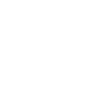

In [55]:
art_museum = philly_tourism.query("name == 'Philadelphia Museum of Art'").squeeze()

art_museum.geometry

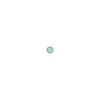

In [56]:
liberty_bell = philly_tourism.query("name == 'Liberty Bell'").squeeze()

liberty_bell.geometry

Now, extract the lat and lng coordinates

For the Art Museum geometry, we can use the `.geometry.centroid` attribute to calculate the centroid of the building footprint. 

In [57]:
liberty_bell_x = liberty_bell.geometry.x
liberty_bell_y = liberty_bell.geometry.y

In [58]:
art_museum_x = art_museum.geometry.centroid.x
art_museum_y = art_museum.geometry.centroid.y

Find the nearest nodes on our OSMnx graph, using the `ox.nearest_nodes()` function


In [59]:
ox.nearest_nodes?

Signature: ox.nearest_nodes(G, X, Y, return_dist=False)
Docstring:
Find the nearest node to a point or to each of several points.

If `X` and `Y` are single coordinate values, this will return the nearest
node to that point. If `X` and `Y` are lists of coordinate values, this
will return the nearest node to each point.

If the graph is projected, this uses a k-d tree for euclidean nearest
neighbor search, which requires that scipy is installed as an optional
dependency. If it is unprojected, this uses a ball tree for haversine
nearest neighbor search, which requires that scikit-learn is installed as
an optional dependency.

Parameters
----------
G : networkx.MultiDiGraph
    graph in which to find nearest nodes
X : float or list
    points' x (longitude) coordinates, in same CRS/units as graph and
    containing no nulls
Y : float or list
    points' y (latitude) coordinates, in same CRS/units as graph and
    containing no nulls
return_dist : bool
    optionally also return distance b

In [60]:
# Get the origin node
orig_node = ox.nearest_nodes(G_cc, liberty_bell_x, liberty_bell_y) 

# Get the destination node
dest_node = ox.nearest_nodes(G_cc, art_museum_x, art_museum_y)

Now, we can use `ox.shortest_path()` function to find the shortest path between these graph nodes.

::: {.callout-note}
We need to specify weight='length' to find the shortest path by minimizing distance traveled (otherwise it treats each edge as weight=1).
:::

In [61]:
# get the shortest path --> just a list of node IDs
route1 = ox.shortest_path(G_cc, orig_node, dest_node, weight="length")

route1

[3408446156,
 110217312,
 109814427,
 5372039288,
 109814445,
 8588123388,
 109814449,
 5358069713,
 5372059864,
 2644235371,
 5534891499,
 110540235,
 109750941,
 110402209,
 110402230,
 534960802,
 110391250,
 637791907,
 637791980,
 110329803,
 110329806,
 775897224,
 3414249481,
 110329822,
 110353061,
 11162290432,
 110054089,
 775897147,
 110329848,
 110329851,
 110125895,
 534969088,
 109745905,
 109740423,
 110330569,
 550175455,
 550175399]

Use `ox.plot_graph_route()` to plot a graph and highlight a specific route

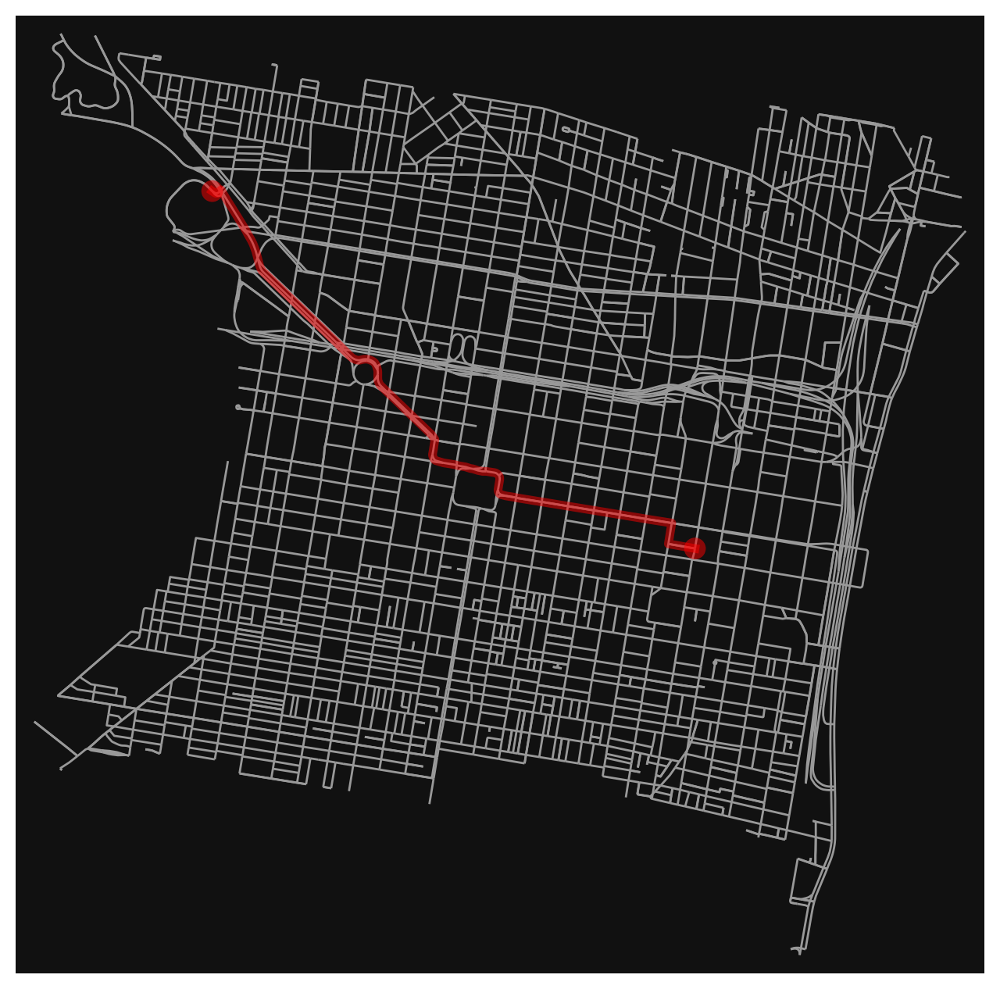

In [62]:
ox.plot_graph_route(G_cc, route1, node_size=0);

How about an interactive version?

`osmnx` has a helper function `ox.utils_graph.route_to_gdf()` to convert a route to a GeoDataFrame of edges.

In [63]:
ox.utils_graph.route_to_gdf(G_cc, route1, weight="length").explore(
    tiles="cartodb positron",
    color="red",
)

#### Finding the shortest travel time


The `add_edge_speeds` function add edge speeds (km per hour) to graph as new `speed_kph` edge attributes. 

The function will add free-flow travel speeds for all edges based on the average `maxspeed` value of edges, per highway type. This process can definitely be imprecise, but in the case that you happen to have more precise speed data, you can supply your own data instead of relying on OSM data. 

In [64]:
# impute speed on all edges missing data
G_cc = ox.add_edge_speeds(G_cc)

# calculate travel time (seconds) for all edges
G_cc = ox.add_edge_travel_times(G_cc)

In [65]:
# Get the graph edges
edges = ox.graph_to_gdfs(G_cc, nodes=False)

In [66]:
edges.head()

osmid  oneway                   name  \
u         v         key                                             
109727439 109911666 0    132508434    True      Bainbridge Street   
109727448 109727439 0     12109011    True  South Colorado Street   
          110034229 0     12159387    True       Fitzwater Street   
109727507 110024052 0    193364514    True       Carpenter Street   
109728761 110274344 0    672312336    True           Brown Street   

                             highway reversed   length  speed_kph  \
u         v         key                                             
109727439 109911666 0    residential    False   44.137       37.0   
109727448 109727439 0    residential    False  109.484       37.0   
          110034229 0    residential    False   91.353       37.0   
109727507 110024052 0    residential    False   53.208       37.0   
109728761 110274344 0    residential    False   58.270       40.2   

                         travel_time  \
u         v         key                
109727439 109911666 0            4.3   
109727448 109727439 0           10.7   
          110034229 0            8.9   
109727507 110024052 0            5.2   
109728761 110274344 0            5.2   

                                                                  geometry  \
u         v         key                                                      
109727439 109911666 0    LINESTRING (-75.17104 39.94345, -75.17053 39.9...   
109727448 109727439 0    LINESTRING (-75.17125 39.94248, -75.17120 39.9...   
          110034229 0    LINESTRING (-75.17125 39.94248, -75.17137 39.9...   
109727507 110024052 0    LINESTRING (-75.17196 39.93973, -75.17134 39.9...   
109728761 110274344 0    LINESTRING (-75.17317 39.96951, -75.17250 39.9...   

                        maxspeed lanes bridge  ref tunnel width service  \
u         v         key                                                   
109727439 109911666 0        NaN   NaN    NaN  NaN    NaN   NaN     NaN   
109727448 109727439 0        NaN   NaN    NaN  NaN    NaN   NaN     NaN   
          110034229 0        NaN   NaN    NaN  NaN    NaN   NaN     NaN   
109727507 110024052 0        NaN   NaN    NaN  NaN    NaN   NaN     NaN   
109728761 110274344 0     25 mph   NaN    NaN  NaN    NaN   NaN     NaN   

                        access junction  
u         v         key                  
109727439 109911666 0      NaN      NaN  
109727448 109727439 0      NaN      NaN  
          110034229 0      NaN      NaN  
109727507 110024052 0      NaN      NaN  
109728761 110274344 0      NaN      NaN

In [67]:
# Groupby highway type and get the mean values
edges["highway"] = edges["highway"].astype(str)
edges.groupby("highway")[["length", "speed_kph", "travel_time"]].mean()

,length,speed_kph,travel_time
highway,,,
"['motorway_link', 'tertiary']",151.615000,47.200000,11.600000
"['secondary', 'primary']",676.801000,43.300000,56.300000
living_street,52.877143,47.200000,4.028571
motorway,451.723346,83.038462,19.323077
motorway_link,295.568174,47.200000,22.550000
primary,103.286915,44.870944,8.251816
primary_link,56.531789,40.200000,5.063158
residential,81.302576,37.001304,7.920488
secondary,93.164418,43.312000,7.877818


In [68]:
# calculate two routes by minimizing travel time
route2 = ox.shortest_path(G_cc, orig_node, dest_node, weight="travel_time")

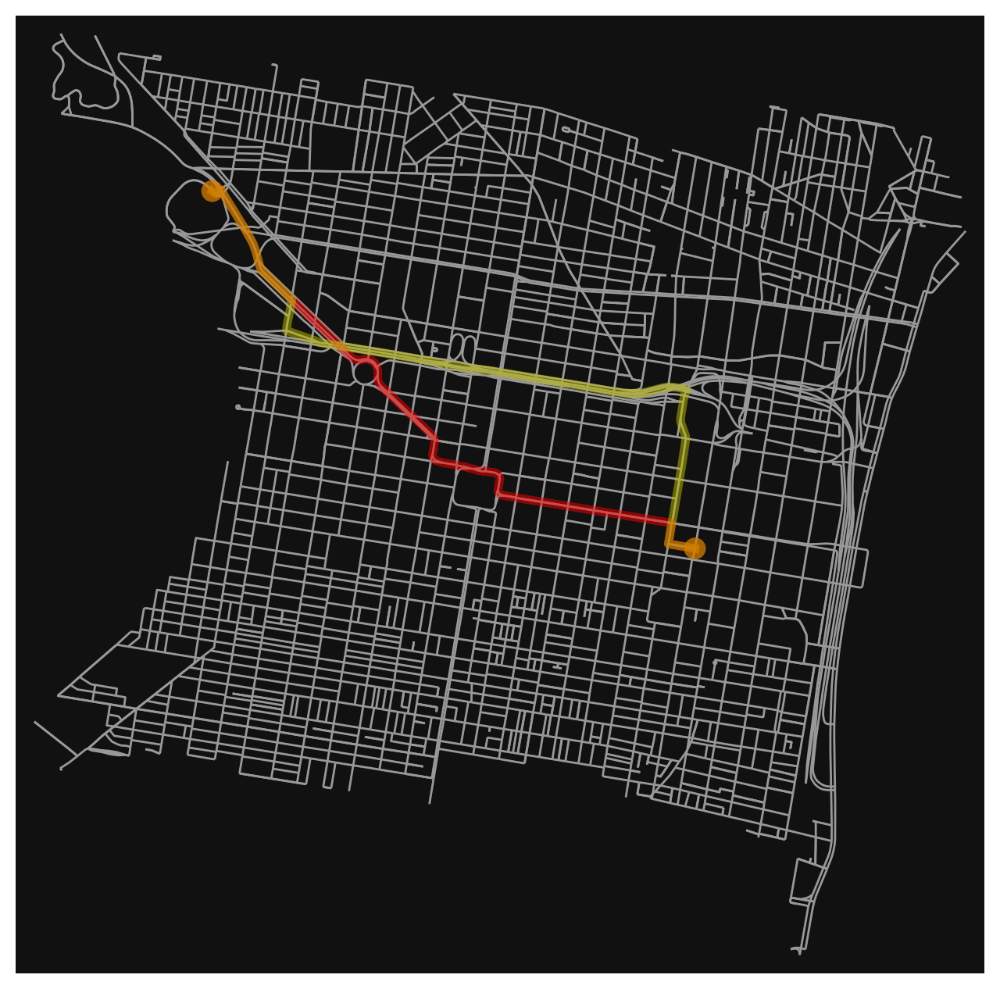

In [69]:
# plot the routes
fig, ax = ox.plot_graph_routes(
    G_cc,
    routes=[route1, route2],
    route_colors=["r", "y"],
    route_linewidth=6,
    node_size=0,
)

Let's plot both in an interactive map:

In [70]:
m = ox.utils_graph.route_to_gdf(G_cc, route1, weight="length").explore(
    tiles="cartodb dark matter",
    color="red",
)

m = ox.utils_graph.route_to_gdf(G_cc, route2, weight="length").explore(
    tiles="cartodb dark matter",
    color="yellow",
    m=m
)

m

Let's compare to the two routes:

Distances:

In [71]:
meters_to_miles = 0.0006213712

# compare the two routes
route1_length = (
    ox.utils_graph.route_to_gdf(G_cc, route1, weight="length")["length"].sum()
    * meters_to_miles
)

route2_length = (
    ox.utils_graph.route_to_gdf(G_cc, route2, weight="length")["length"].sum()
    * meters_to_miles
)

Travel times:

In [72]:
seconds_to_mins = 1.0 / 60

route1_time = (
    ox.utils_graph.route_to_gdf(G_cc, route1, weight="travel_time")["travel_time"].sum()
    * seconds_to_mins
)
route2_time = (
    ox.utils_graph.route_to_gdf(G_cc, route2, weight="travel_time")["travel_time"].sum()
    * seconds_to_mins
)

Summarize:

In [73]:
print(f"Route 1 is {route1_length:.2f} miles and takes {route1_time:.2f} minutes.")
print(f"Route 2 is {route2_length:.2f} miles and takes {route2_time:.2f} minutes.")

Route 1 is 2.19 miles and takes 5.04 minutes.
Route 2 is 2.46 miles and takes 4.46 minutes.


## Part 2:  Pandana

"Pandas Network Analysis - dataframes of network queries, quickly"

A complementary set of OSM-related features: 
- Downloading OSM-based networks
- Extracting amenity data (so-called "Points of Interest")
- Calculating network-constrained distances

- [GitHub](https://github.com/UDST/pandana)
- [Jupyter Notebook Examples](https://github.com/UDST/pandana/tree/master/examples)
- [Documentation](http://udst.github.io/pandana/)

In [74]:
import pandana as pnda
from pandana.loaders import osm

### Step 1: Get amenity data

Key function: `osm.node_query()`

- This will extract amenities within a given bounding box.
- Similar to the `ox.geometries_from_bbox()` function in OSMnx, but we slightly different syntax.

In [75]:
osm.node_query?

Signature: osm.node_query(lat_min, lng_min, lat_max, lng_max, tags=None)
Docstring:
Search for OSM nodes within a bounding box that match given tags.

Parameters
----------
lat_min, lng_min, lat_max, lng_max : float
tags : str or list of str, optional
    Node tags that will be used to filter the search.
    See http://wiki.openstreetmap.org/wiki/Overpass_API/Language_Guide
    for information about OSM Overpass queries
    and http://wiki.openstreetmap.org/wiki/Map_Features
    for a list of tags.

Returns
-------
nodes : pandas.DataFrame
    Will have 'lat' and 'lon' columns, plus other columns for the
    tags associated with the node (these will vary based on the query).
    Index will be the OSM node IDs.
File:      ~/mambaforge/envs/musa-550-fall-2023/lib/python3.10/site-packages/pandana/loaders/osm.py
Type:      function

Get the bounding box:

In [76]:
boundary = center_city_outline.bounds
boundary

(-75.193582452986, 39.9286257450627, -75.1259307965391, 39.9738724134056)

In [77]:
[lng_min, lat_min, lng_max, lat_max] = boundary

In [78]:
# query OSM
poi_df = osm.node_query(lat_min, lng_min, lat_max, lng_max)

# remove missing data
poi_df = poi_df.dropna(subset=["amenity"])

In [79]:
poi_df.head()

,lat,lon,railway,light_rail,name,network,operator,public_transport,wheelchair,highway,traffic_signals,old_ref,ref,noref,traffic_signals:direction,direction,traffic_calming,crossing,crossing:markings,tactile_paving,stop,noexit,crossing:barrier,barrier,crossing:island,disused:railway,crossing_ref,supervised,railway:signal:direction,ele,gnis:feature_id,place,wikidata,wikipedia,alt_name,gnis:Class,gnis:County,gnis:County_num,gnis:ST_alpha,gnis:ST_num,import_uuid,is_in,name:en,name:zh,amenity,brand,brand:wikidata,brand:wikipedia,operator:wikidata,operator:wikipedia,short_name,addr:city,addr:housenumber,addr:postcode,addr:state,addr:street,contact:website,cuisine,official_name,opening_hours,phone,takeaway,shop,website,ferry,building,addr:housename,healthcare,internet_access,internet_access:ssid,brewery,description,gnis:county_id,gnis:created,gnis:state_id,historic:amenity,note,old_name,craft,microbrewery,restaurant,leisure,sport,man_made,tower:type,gnis:edited,operator:short,operator:type,check_date,emergency,healthcare:speciality,railway:position,train,artwork_type,historic,tourism,atm,information,artist_name,material,attraction,office,bench,bus,covered,network:wikidata,shelter,memorial,gnis:county_name,gnis:import_uuid,gnis:reviewed,comment,historic:tourism,aeroway,gnis:feature_type,addr:country,platforms,station,subway,kerb,junction,iata,railway:ref,railway:switch:local_operated,railway:signal:position,addr:unit,internet_access:fee,crossing:light,start_date,subject:wikidata,artwork_subject,image,statue,tram,contact:facebook,email,reservation,website:menu,colour,parking,designation,not:brand:wikidata,entrance,denomination,religion,screen,delivery,diet:vegan,outdoor_seating,payment:cash,payment:coins,air_conditioning,contact:phone,indoor_seating,smoking,architect,disused:amenity,contact:instagram,network:wikipedia,collection_times,male,female,dispensing,name:de,drive_through,diet:vegetarian,fax,bar,service:bicycle:pump,service:bicycle:repair,service:bicycle:retail,toilets:wheelchair,route_ref,capacity,source:pkey,power,access,level,museum,name:he,fuel:biodiesel,fuel:biogas,fuel:cng,fuel:diesel,fuel:e10,fuel:e85,fuel:electricity,collection_times:signed,ref:signed,check_date:collection_times,clothes,addr:full,branch,name:ja,operator:en,fair_trade,organic,disused:shop,fixme,artist:wikidata,inscription:url,name:ga,contact:email,payment:bitcoin,source:name,phone:mnemonic,disused:brand,disused:brand:wikidata,disused:brand:wikipedia,disused:dispensing,disused:drive_through,disused:healthcare,disused:opening_hours,diet:pescetarian,lgbtq,payment:credit_cards,payment:debit_cards,drink:club-mate,fare_zone,toilets,toilets:access,building:levels,is_in:state_code,population,farm_boxes,compost,addr:place,social_facility,check_date:opening_hours,source:cuisine,social_facility:for,demolished:amenity,demolished:opening_hours,demolished:phone,demolished:social_facility,maxheight,access:delivery,wheelchair:description,wheelchair:description:en,beauty,elevation,fee,park_ride,layer,height,name:es,service:bicycle:chain_tool,natural,name:fr,name:signed,bin,lit,departures_board,denotation,facebook,currency:USD,drink:coca-cola,drink:coke,drink:cola,drink:cola_zero,drink:soda,drink:water,vending,opening_hours:kitchen,bicycle_rental,disused:leisure,year_of_construction,name:ru,toilets:unisex,toilets:disposal,unisex,kitchen_hours,currency:XBT,animal,owner,button_operated,traffic_signals:sound,traffic_signals:vibration,source:lgbtq,service:bicycle:rental,service:bicycle:second_hand,bicycle,horse,motor_vehicle,bottle,surface,lamp_type,theatre:genre,service:bicycle:tools,bicycle_parking,ref:retrofitness,leaf_cycle,leaf_type,capital,loc_name,name:ar,name:azb,name:be,name:bn,name:ca,name:cs,name:el,name:fa,name:grc,name:hi,name:it,name:kn,name:ko,name:lv,name:moh,name:oc,name:ono,name:pa,name:pl,name:pt,name:sr,name:ta,name:te,name:tr,name:uk,name:ur,name:zh-Hans,name:zh-Hant,population:date,source:name:oc,source:population,payment:cheque,advertising,payment:americ

In [80]:
len(poi_df)

2383

In [81]:
poi_df[["lat", "lon", "amenity"]].head(10)

,lat,lon,amenity
id,,,
274216093,39.957640,-75.191254,atm
274217596,39.953015,-75.192289,cafe
313440966,39.963935,-75.166939,car_sharing
313440968,39.963978,-75.170407,car_sharing
326519551,39.944261,-75.132616,ferry_terminal
333786044,39.940858,-75.158928,restaurant
333786095,39.941924,-75.157357,cafe
333786448,39.942642,-75.157958,bank
333786774,39.943102,-75.160030,pharmacy


#### Explore the amenities in this region

For the full list of amenities, see the [OSM Wikipedia](https://wiki.openstreetmap.org/wiki/Key:amenity)

In [82]:
chart = (
    alt.Chart(poi_df)
    .mark_bar()
    .encode(y=alt.Y("amenity", sort="-x"), x="count()", tooltip=["amenity", "count()"])
)

chart

/Users/nhand/mambaforge/envs/musa-550-fall-2023/lib/python3.10/site-packages/altair/utils/schemapi.py:353: DeprecationWarning: jsonschema.RefResolver is deprecated as of v4.18.0, in favor of the https://github.com/python-jsonschema/referencing library, which provides more compliant referencing behavior as well as more flexible APIs for customization. A future release will remove RefResolver. Please file a feature request (on referencing) if you are missing an API for the kind of customization you need.
  resolver = jsonschema.RefResolver.from_schema(root or schema)
/Users/nhand/mambaforge/envs/musa-550-fall-2023/lib/python3.10/site-packages/altair/utils/schemapi.py:118: DeprecationWarning: jsonschema.RefResolver is deprecated as of v4.18.0, in favor of the https://github.com/python-jsonschema/referencing library, which provides more compliant referencing behavior as well as more flexible APIs for customization. A future release will remove RefResolver. Please file a feature request (on

alt.Chart(...)

### Step 2: Create a Pandana network

- Key function: `pdna_network_from_bbox()` 
- It takes a bounding box and returns the OSM network within that region. 
- Multiple network types: 'walk' and 'drive'

In [83]:
net = osm.pdna_network_from_bbox(
    lat_min, lng_min, lat_max, lng_max, network_type="walk"
)

Requesting network data within bounding box from Overpass API in 1 request(s)
Posting to http://www.overpass-api.de/api/interpreter with timeout=180, "{'data': '[out:json][timeout:180];(way["highway"]["highway"!~"motor|proposed|construction|abandoned|platform|raceway"]["foot"!~"no"]["pedestrians"!~"no"](39.92862575,-75.19358245,39.97387241,-75.12593080);>;);out;'}"
Downloaded 7,222.6KB from www.overpass-api.de in 1.06 seconds
Downloaded OSM network data within bounding box from Overpass API in 1 request(s) and 1.13 seconds
Returning OSM data with 38,115 nodes and 11,964 ways...
Edge node pairs completed. Took 3.49 seconds
Returning processed graph with 17,673 nodes and 26,526 edges...
Completed OSM data download and Pandana node and edge table creation in 4.87 seconds
Generating contraction hierarchies with 10 threads.
Setting CH node vector of size 17673
Setting CH edge vector of size 26746
Range graph removed 994 edges of 53492
. 10% . 20% . 30% . 40% . 50% . 60% . 70% . 80% . 90% . 

### Step 3: Tell the network the location of amenities

Key function: `network.set_pois()`

- Today, we'll explore these four amenities: "restaurant", "bar", "school", "car_sharing"
- **IMPORTANT:** if you want to explore other amenities, you'll need to run the code below for your amenities of interest

In [84]:
# sensible defaults
max_distance = 2000  # in meters
num_pois = 10  # only need the 10 nearest POI to each point in the network


AMENITIES = ["restaurant", "bar", "school", "car_sharing"]
for amenity in AMENITIES:
    # get the subset of amenities for this type
    pois_subset = poi_df[poi_df["amenity"] == amenity]

    # set the POI, using the longitude and latitude of POI
    net.set_pois(
        amenity, max_distance, num_pois, pois_subset["lon"], pois_subset["lat"]
    )

In [85]:
# keyword arguments to pass for the matplotlib figure
bbox_aspect_ratio = (lat_max - lat_min) / (lng_max - lng_min)
fig_kwargs = {"facecolor": "w", "figsize": (10, 10 * bbox_aspect_ratio)}

# keyword arguments to pass for scatter plots
plot_kwargs = {"s": 20, "alpha": 0.9, "cmap": "viridis_r", "edgecolor": "none"}

### Step 4: Plot the walking distance to the nearest POI

For every point on the network, find the nth nearest POI, calculate the distance, and color that point according to the distance.

1. Use `network.nearest_poi()` to get distances from nodes to nearest POIs
1. Merge coordinates of network nodes with distances to nearest POIs
1. Plot the node coordinates, colored by distance to nth nearest POI

#### 4.1 Use `network.nearest_poi()` to get distances from nodes to nearest POIs

In [86]:
amenity = "bar"
access = net.nearest_pois(distance=2000, category=amenity, num_pois=num_pois)

In [87]:
access.head(n=20)

,1,2,3,4,5,6,7,8,9,10
id,,,,,,,,,,
103327043,1752.093018,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103332711,988.283020,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103332730,670.846008,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103333406,597.692993,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103333412,623.888977,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103333415,622.456970,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103338754,712.594971,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103338757,744.122986,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103338759,770.111023,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0


#### 4.2 Merge coordinates of network nodes with distances to nearest POIs

In [88]:
net.nodes_df.head()

,x,y
id,,
103327043,-75.128666,39.934488
103332711,-75.128062,39.939224
103332730,-75.129329,39.941869
103333406,-75.130257,39.943351
103333412,-75.130332,39.943123


In [89]:
access.head()

,1,2,3,4,5,6,7,8,9,10
id,,,,,,,,,,
103327043,1752.093018,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103332711,988.283020,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103332730,670.846008,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103333406,597.692993,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0
103333412,623.888977,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0


In [90]:
# Merge the nodes and the distance to POIs
nodes = pd.merge(net.nodes_df, access, left_index=True, right_index=True)

# Make into a geodataframe
nodes = gpd.GeoDataFrame(
    nodes, geometry=gpd.points_from_xy(nodes["x"], nodes["y"]), crs="EPSG:4326"
)

In [91]:
nodes.head()

,x,y,1,2,3,4,5,6,7,8,9,10,geometry
id,,,,,,,,,,,,,
103327043,-75.128666,39.934488,1752.093018,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,POINT (-75.12867 39.93449)
103332711,-75.128062,39.939224,988.283020,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,POINT (-75.12806 39.93922)
103332730,-75.129329,39.941869,670.846008,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,POINT (-75.12933 39.94187)
103333406,-75.130257,39.943351,597.692993,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,POINT (-75.13026 39.94335)
103333412,-75.130332,39.943123,623.888977,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0,POINT (-75.13033 39.94312)


#### 4.3 And now plot it!

Let's define a function to do this for us, since we'll repeat this plot multiple times

In [92]:
def plot_walking_distance(net, amenity, distance=1000, n=1):
    """
    Plot the walking distance to the specified amenity
    """
    from mpl_toolkits.axes_grid1 import make_axes_locatable

    # subset of POI
    poi_subset = poi_df[poi_df["amenity"] == amenity]

    # get the distances to nearest num_pois POI
    access = net.nearest_pois(distance=1000, category=amenity, num_pois=num_pois)

    # merge node positions and distances to nearest PO
    nodes = pd.merge(net.nodes_df, access, left_index=True, right_index=True)
    nodes = gpd.GeoDataFrame(
        nodes, geometry=gpd.points_from_xy(nodes["x"], nodes["y"]), crs="EPSG:4326"
    )

    # Create the figure
    fig, ax = plt.subplots(figsize=(10, 10))
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)

    # plot the distance to the nth nearest amenity
    ax = nodes.plot(ax=ax, cax=cax, column=nodes[n], legend=True, **plot_kwargs)

    # add the amenities as stars
    for i, row in poi_subset.iterrows():
        ax.scatter(row["lon"], row["lat"], color="red", s=100, marker="*")

    # format
    ax.set_facecolor("black")
    ax.figure.set_size_inches(fig_kwargs["figsize"])

    # set extent
    [xmin, ymin, xmax, ymax] = nodes.geometry.total_bounds
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)

    return ax

### Evaluating amenity choice

The difference between maps to the nearest amenity and for example, the 5th nearest amenity tells us about the options consumers have

#### Example: bars

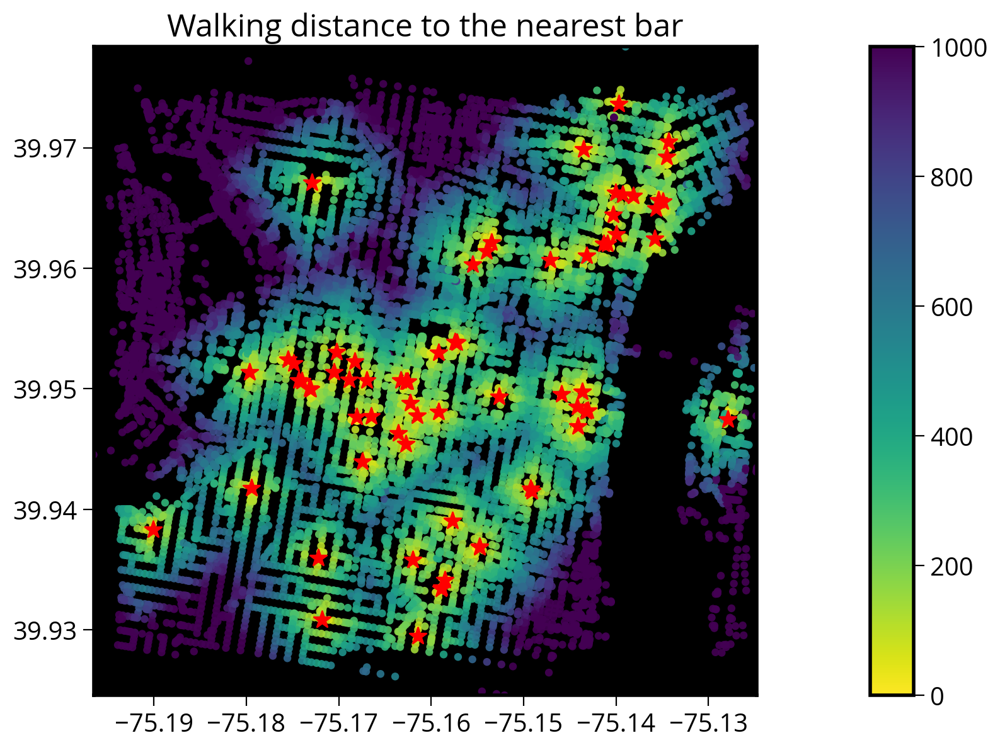

In [93]:
ax = plot_walking_distance(net, "bar", n=1)
ax.set_title("Walking distance to the nearest bar", fontsize=18);

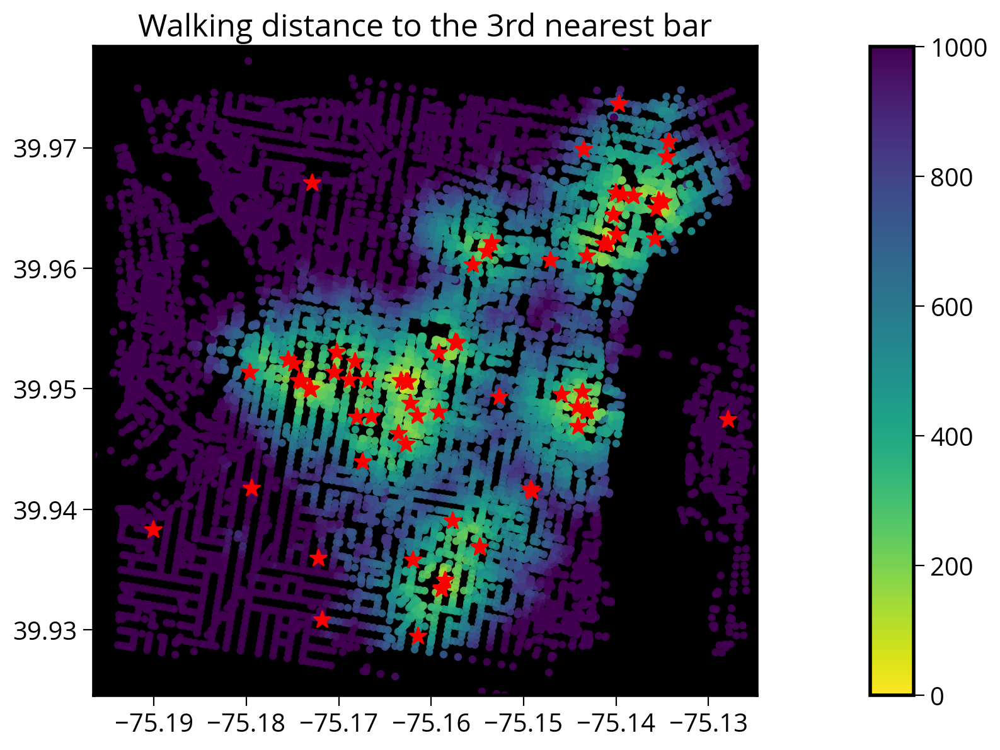

In [94]:
ax = plot_walking_distance(net, "bar", n=3)
ax.set_title("Walking distance to the 3rd nearest bar", fontsize=18);

#### Example: schools

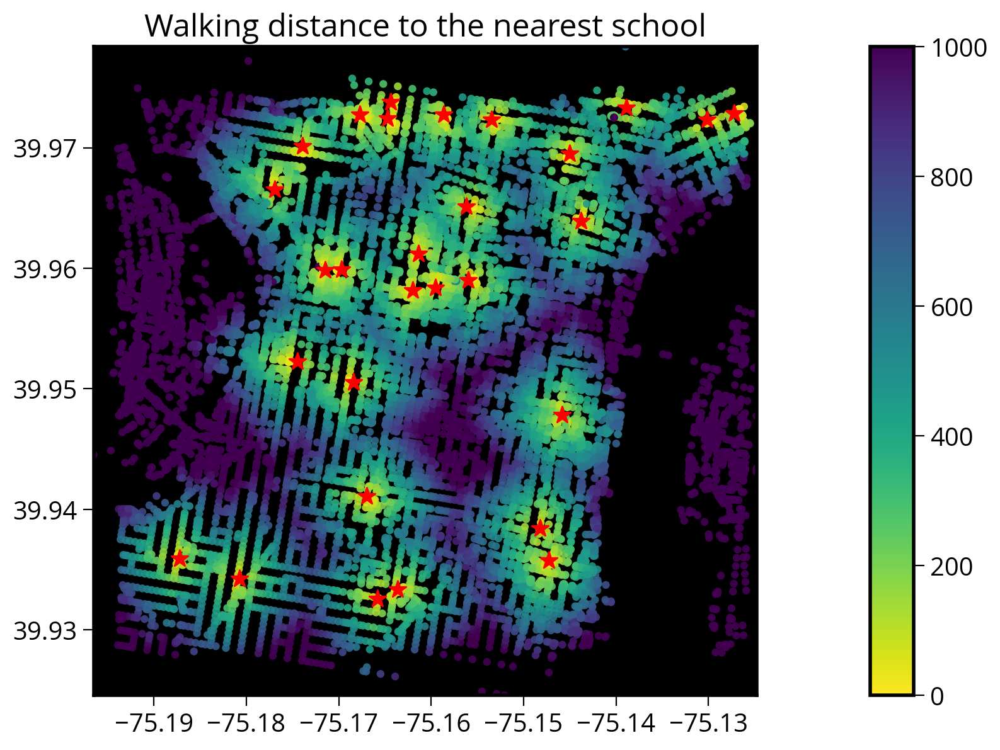

In [95]:
ax = plot_walking_distance(net, "school", n=1)
ax.set_title("Walking distance to the nearest school", fontsize=18);

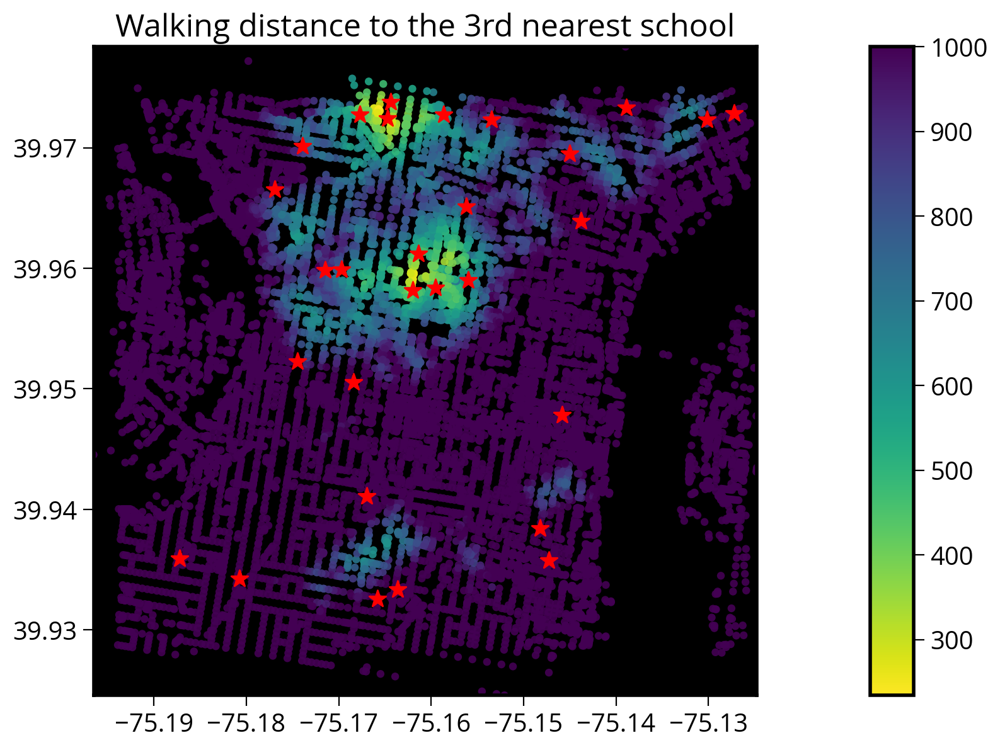

In [96]:
ax = plot_walking_distance(net, "school", n=3)
ax.set_title("Walking distance to the 3rd nearest school", fontsize=18);

#### Example: restaurants

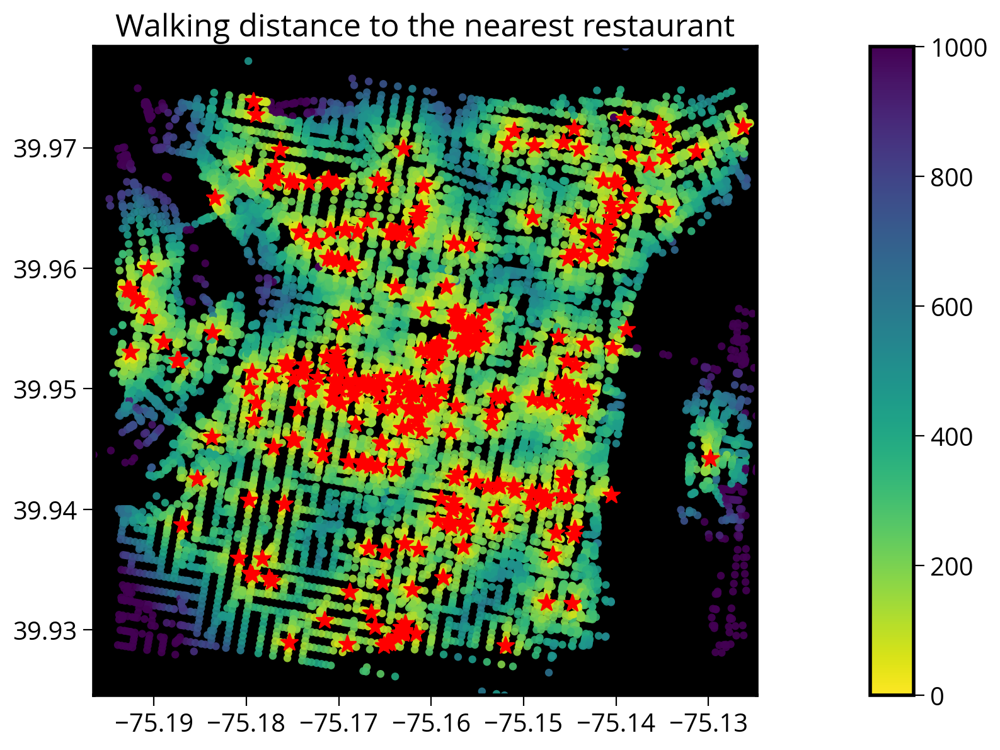

In [97]:
ax = plot_walking_distance(net, "restaurant", n=1)
ax.set_title("Walking distance to the nearest restaurant", fontsize=18);

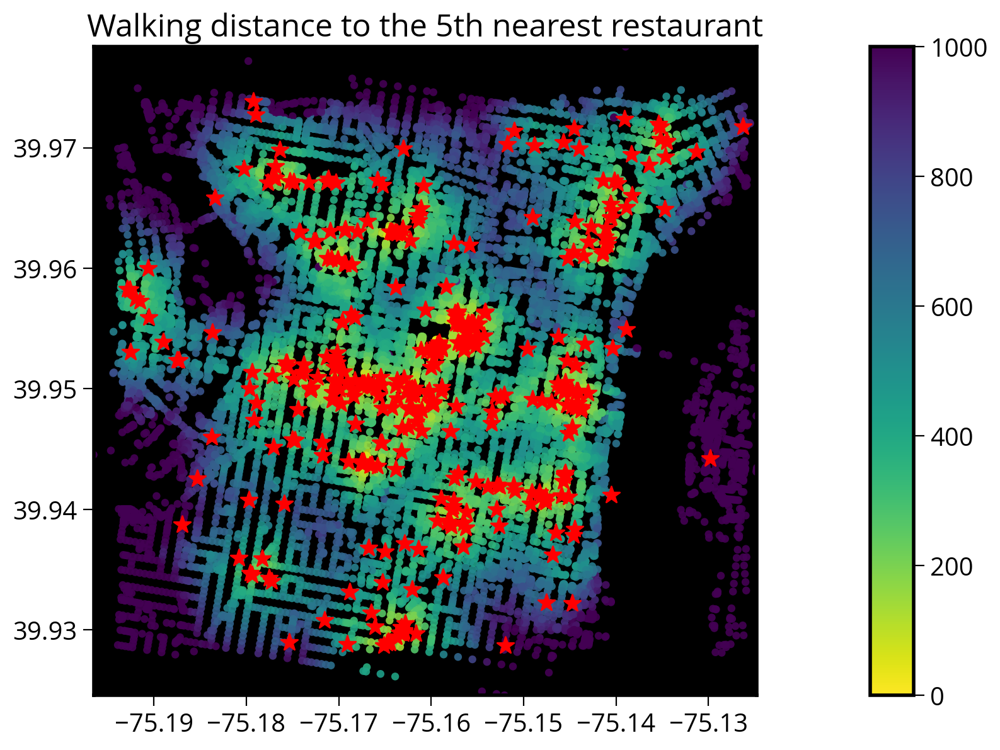

In [98]:
ax = plot_walking_distance(net, "restaurant", n=5)
ax.set_title("Walking distance to the 5th nearest restaurant", fontsize=18);

#### Example: car sharing

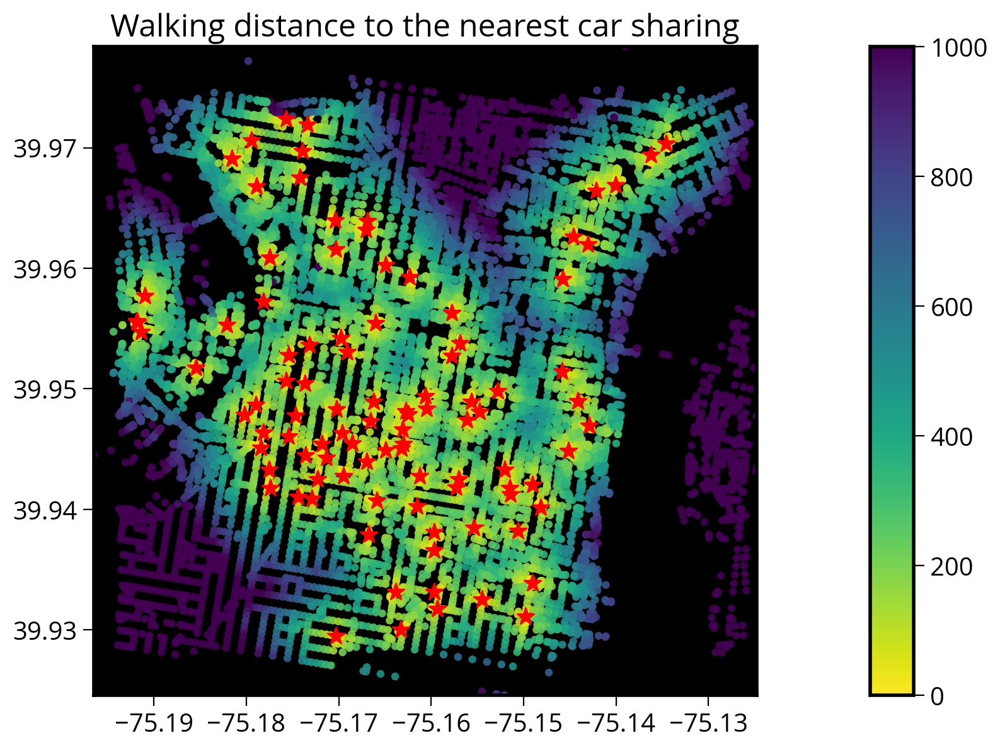

In [99]:
ax = plot_walking_distance(net, "car_sharing", n=1)
ax.set_title("Walking distance to the nearest car sharing", fontsize=18);

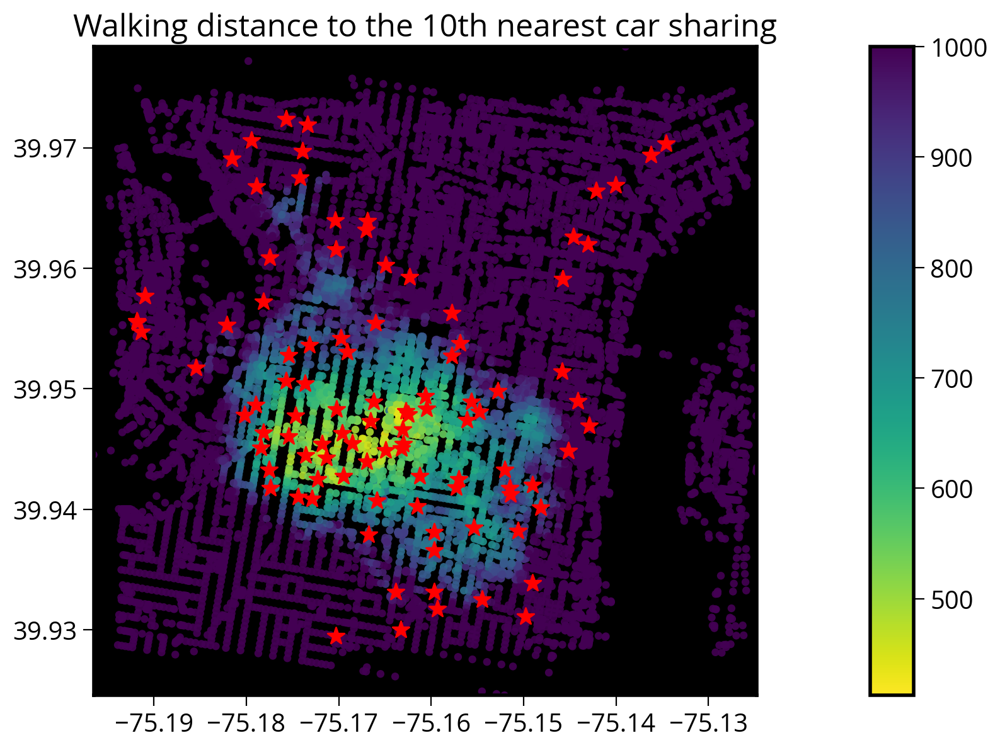

In [100]:
ax = plot_walking_distance(net, "car_sharing", n=10)
ax.set_title("Walking distance to the 10th nearest car sharing", fontsize=18);

## At-home exercise: Explore amenities in the neighborhood of your choice

Many, many more amenities are logged throughout the city. Pick your favorite neighborhood and explore. 

See [this page](https://wiki.openstreetmap.org/wiki/Key:amenity) for the full list of amenities.

**Final project idea**: With this kind of analysis, you can look at amenity-based influence in housing, neighborhood selection, etc. or something similar to the [Walk Score](https://www.walkscore.com/).